In [1]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms as T
import torchvision
import torch.nn.functional as F
from torch.autograd import Variable
from PIL import Image
import cv2
import albumentations as A
import time
import os
from tqdm.notebook import tqdm

/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.5' (you have '2.0.4'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [2]:
!pip install -q segmentation-models-pytorch
!pip install -q torchsummary
!pip install -q efficientnet_pytorch

In [3]:
import segmentation_models_pytorch as smp
from efficientnet_pytorch import EfficientNet

In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

from segmentation_models_pytorch.losses import FocalLoss

Using device: cuda


In [5]:
BASE_PATH = '/kaggle/input/aerial-imagery-dataset-floodnet-challenge/FloodNet Challenge - Track 1'  
TRAIN_FLOODED_IMG_PATH = os.path.join(BASE_PATH, 'Train/Labeled/Flooded/image/')
TRAIN_FLOODED_MASK_PATH = os.path.join(BASE_PATH, 'Train/Labeled/Flooded/mask/')
TRAIN_NONFLOODED_IMG_PATH = os.path.join(BASE_PATH, 'Train/Labeled/Non-Flooded/image/')
TRAIN_NONFLOODED_MASK_PATH = os.path.join(BASE_PATH, 'Train/Labeled/Non-Flooded/mask/')
TRAIN_UNLABELED_IMG_PATH = os.path.join(BASE_PATH, 'Train/Unlabeled/image/')
VAL_IMG_PATH = os.path.join(BASE_PATH, 'Validation/image/')
TEST_IMG_PATH = os.path.join(BASE_PATH, 'Test/image/')

In [6]:
n_classes = 11  

In [7]:
# -------------- PREPROCESSING FUNCTIONS --------------

def preprocess_image(image, target_size=(512, 512)):
    """
    Preprocess image: crop last 1000 pixels along width and resize to target_size
    """
    # Check if image is already loaded or needs to be loaded from path
    if isinstance(image, str):
        img = cv2.imread(image)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    else:
        img = image.copy()
    
    # Get dimensions
    h, w = img.shape[:2]
    
    # Crop last 1000 pixels from width to make it more square
    # Original size: 3000x4000 -> Crop to 3000x3000
    if w > 3000:  # Only crop if the image is wider than expected
        img = img[:, :w-1000]
    
    # Resize to target size
    img = cv2.resize(img, target_size)
    
    return img

def preprocess_mask(mask, target_size=(512, 512)):
    """
    Preprocess mask: crop last 1000 pixels along width and resize to target_size
    """
    # Check if mask is already loaded or needs to be loaded from path
    if isinstance(mask, str):
        # Note: masks should be loaded as grayscale
        msk = cv2.imread(mask, cv2.IMREAD_GRAYSCALE)
    else:
        msk = mask.copy()
    
    # Get dimensions
    h, w = msk.shape[:2]
    
    # Crop last 1000 pixels from width to make it more square
    if w > 3000:  # Only crop if the mask is wider than expected
        msk = msk[:, :w-1000]
    
    # Resize to target size using nearest neighbor interpolation to preserve label values
    msk = cv2.resize(msk, target_size, interpolation=cv2.INTER_NEAREST)
    
    return msk

In [8]:
# -------------- DATASET CREATION --------------

def create_df():
    """
    Create a dataframe containing all labeled images from both flooded and non-flooded directories
    """
    data = []
    
    # Get flooded images
    for filename in os.listdir(TRAIN_FLOODED_IMG_PATH):
        if filename.endswith(('.jpg', '.png')):
            image_id = filename.split('.')[0]
            mask_filename = f"{image_id}_lab.png"  # Add _lab suffix for mask files
            
            if os.path.exists(os.path.join(TRAIN_FLOODED_MASK_PATH, mask_filename)):
                data.append({
                    'id': image_id,
                    'image_path': os.path.join(TRAIN_FLOODED_IMG_PATH, filename),
                    'mask_path': os.path.join(TRAIN_FLOODED_MASK_PATH, mask_filename),
                    'is_flooded': 1
                })
    
    # Get non-flooded images
    for filename in os.listdir(TRAIN_NONFLOODED_IMG_PATH):
        if filename.endswith(('.jpg', '.png')):
            image_id = filename.split('.')[0]
            mask_filename = f"{image_id}_lab.png"  # Add _lab suffix for mask files
            
            if os.path.exists(os.path.join(TRAIN_NONFLOODED_MASK_PATH, mask_filename)):
                data.append({
                    'id': image_id,
                    'image_path': os.path.join(TRAIN_NONFLOODED_IMG_PATH, filename),
                    'mask_path': os.path.join(TRAIN_NONFLOODED_MASK_PATH, mask_filename),
                    'is_flooded': 0
                })
    
    return pd.DataFrame(data)

In [9]:
# Create main dataframe
df = create_df()
print('Total Labeled Images:', len(df))
print('Flooded Images:', sum(df['is_flooded'] == 1))
print('Non-Flooded Images:', sum(df['is_flooded'] == 0))

# Split data into train and validation sets
X_train, X_val = train_test_split(df, test_size=0.15, random_state=42, stratify=df['is_flooded'])

print('Train Size:', len(X_train))
print('Validation Size:', len(X_val))

Total Labeled Images: 398
Flooded Images: 51
Non-Flooded Images: 347
Train Size: 338
Validation Size: 60


In [10]:
# -------------- DATASET CLASS --------------

class FloodNetDataset(Dataset):
    def __init__(self, dataframe, transform=None, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
        self.dataframe = dataframe
        self.transform = transform
        self.mean = mean
        self.std = std

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        row = self.dataframe.iloc[idx]
        
        # Load and preprocess image
        img = preprocess_image(row['image_path'])
        
        # Load and preprocess mask
        mask = preprocess_mask(row['mask_path'])
        
        # Apply transformations if specified
        if self.transform is not None:
            augmented = self.transform(image=img, mask=mask)
            img = augmented['image']
            mask = augmented['mask']
        
        # Convert image to tensor and normalize
        img = Image.fromarray(img)
        t = T.Compose([T.ToTensor(), T.Normalize(self.mean, self.std)])
        img = t(img)
        
        # Convert mask to tensor
        mask = torch.from_numpy(mask).long()
        
        return img, mask


In [11]:
# -------------- CONFIGURATION --------------

class Config:
    IMAGE_SIZE = (512, 512)
    BATCH_SIZE = 8
    NUM_CLASSES = 11  # Adjust based on class_mapping.csv
    LEARNING_RATE = 0.0001
    NUM_EPOCHS = 25
    ENCODER = 'timm-efficientnet-b0'
    WEIGHTS = 'imagenet'
    DEVICE = device

In [12]:
# -------------- DATA AUGMENTATION --------------

# Define transformations
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

# Augmentations for training
train_transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.ShiftScaleRotate(p=0.2),
])

# Augmentations for validation (minimal)
val_transform = A.Compose([])

/usr/local/lib/python3.11/dist-packages/albumentations/core/validation.py:58: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)


In [13]:
# -------------- CREATE DATASETS & DATALOADERS --------------

# Create datasets
train_dataset = FloodNetDataset(X_train, transform=train_transform, mean=mean, std=std)
val_dataset = FloodNetDataset(X_val, transform=val_transform, mean=mean, std=std)

# Create dataloaders
train_loader = DataLoader(train_dataset, batch_size=Config.BATCH_SIZE, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=Config.BATCH_SIZE, shuffle=False, num_workers=4)


In [14]:
# -------------- SEGMENTATION MODEL --------------

def create_segmentation_model():
    model = smp.DeepLabV3Plus(
        encoder_name=Config.ENCODER,       
        encoder_weights=Config.WEIGHTS,   
        in_channels=3,               
        classes=Config.NUM_CLASSES,    
    )
    return model.to(Config.DEVICE)

In [15]:
# Initialize model
segmentation_model = create_segmentation_model()
print("Segmentation model created:")
print(segmentation_model)

# Define loss function (Focal Loss for handling class imbalance)
from segmentation_models_pytorch.losses import FocalLoss
criterion = FocalLoss(mode="multiclass", ignore_index=255)

# Define optimizer
optimizer = torch.optim.Adam(segmentation_model.parameters(), lr=Config.LEARNING_RATE)

Segmentation model created:
DeepLabV3Plus(
  (encoder): EfficientNetEncoder(
    (conv_stem): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNormAct2d(
      32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
      (drop): Identity()
      (act): Swish()
    )
    (blocks): Sequential(
      (0): Sequential(
        (0): DepthwiseSeparableConv(
          (conv_dw): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (bn1): BatchNormAct2d(
            32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
            (drop): Identity()
            (act): Swish()
          )
          (aa): Identity()
          (se): SqueezeExcite(
            (conv_reduce): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (act1): Swish()
            (conv_expand): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (gate): Sigmoid()
          )
          (conv_pw)

In [16]:
# -------------- TRAINING FUNCTIONS --------------

def train_one_epoch(model, loader, criterion, optimizer):
    model.train()
    total_loss = 0
    
    for images, masks in tqdm(loader, desc="Training"):
        images, masks = images.to(Config.DEVICE), masks.to(Config.DEVICE)
        
        # Forward pass
        outputs = model(images)
        loss = criterion(outputs, masks)
        
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        total_loss += loss.item()
    
    return total_loss / len(loader)

def evaluate(model, loader, criterion):
    model.eval()
    total_loss = 0
    
    with torch.no_grad():
        for images, masks in tqdm(loader, desc="Evaluating"):
            images, masks = images.to(Config.DEVICE), masks.to(Config.DEVICE)
            
            # Forward pass
            outputs = model(images)
            loss = criterion(outputs, masks)
            
            total_loss += loss.item()
    
    return total_loss / len(loader)

In [17]:
# -------------- VISUALIZATION FUNCTIONS --------------

# Define colors for each class
class_colors = [
    (0, 0, 0),          # Background
    (102, 102, 0),      # Building Flooded
    (204, 204, 0),      # Building Non-Flooded
    (96, 96, 96),       # Road Flooded
    (160, 160, 160),    # Road Non-Flooded
    (153, 204, 255),    # Water
    (0, 153, 76),       # Tree
    (255, 51, 51),      # Vehicle
    (0, 128, 255),      # Pool
    (153, 255, 51),     # Grass
    (255, 255, 255)     # Unlabelled
]

class_colors_dict = {i: class_colors[i] for i in range(Config.NUM_CLASSES)}
class_colors_dict[255] = (255, 255, 255)  # White for Unlabelled

In [18]:
def visualize_predictions(model, loader, device, num_samples=3):
    model.eval()
    samples_shown = 0
    
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            
            outputs = model(images)
            predictions = torch.argmax(outputs, dim=1)
            
            for i in range(images.size(0)):
                if samples_shown >= num_samples:
                    return
                
                # Get numpy arrays from tensors
                image = images[i].cpu().permute(1, 2, 0).numpy()
                mask = masks[i].cpu().numpy()
                prediction = predictions[i].cpu().numpy()
                
                # Denormalize image for display
                image = image * np.array(std) + np.array(mean)
                image = np.clip(image, 0, 1)
                
                # Create colored mask and prediction
                mask_color = np.zeros((*mask.shape, 3), dtype=np.uint8)
                pred_color = np.zeros((*prediction.shape, 3), dtype=np.uint8)
                
                for label, color in class_colors_dict.items():
                    mask_color[mask == label] = color
                    pred_color[prediction == label] = color
                
                # Display images
                plt.figure(figsize=(15, 5))
                
                plt.subplot(1, 3, 1)
                plt.title("Input Image")
                plt.imshow(image)
                plt.axis("off")
                
                plt.subplot(1, 3, 2)
                plt.title("Ground Truth")
                plt.imshow(mask_color)
                plt.axis("off")
                
                plt.subplot(1, 3, 3)
                plt.title("Prediction")
                plt.imshow(pred_color)
                plt.axis("off")
                
                plt.tight_layout()
                plt.show()
                samples_shown += 1

def plot_training_curve(train_losses, val_losses):
    plt.figure(figsize=(10, 5))
    plt.plot(train_losses, label="Training Loss")
    plt.plot(val_losses, label="Validation Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Training and Validation Loss")
    plt.legend()
    plt.grid(True)
    plt.show()

In [19]:
# -------------- TRAINING LOOP --------------

def train_segmentation_model(model, num_epochs, train_loader, val_loader, criterion, optimizer):
    train_losses = []
    val_losses = []
    best_val_loss = float('inf')
    
    for epoch in range(num_epochs):
        start_time = time.time()
        
        # Train
        train_loss = train_one_epoch(model, train_loader, criterion, optimizer)
        
        # Evaluate
        val_loss = evaluate(model, val_loader, criterion)
        
        # Save losses
        train_losses.append(train_loss)
        val_losses.append(val_loss)
        
        # Print metrics
        epoch_time = time.time() - start_time
        print(f"Epoch {epoch+1}/{num_epochs} - {epoch_time:.2f}s")
        print(f"Training Loss: {train_loss:.4f}")
        print(f"Validation Loss: {val_loss:.4f}")
        
        # Save best model
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.state_dict(), 'best_segmentation_model.pth')
            print("Saved best model checkpoint")
        
        # Visualize predictions every 5 epochs
        if (epoch + 1) % 5 == 0 or epoch == 0:
            print(f"Visualizing predictions after Epoch {epoch+1}")
            visualize_predictions(model, val_loader, Config.DEVICE, num_samples=2)
            plot_training_curve(train_losses, val_losses)
    
    # Load best model
    model.load_state_dict(torch.load('best_segmentation_model.pth'))
    return model, train_losses, val_losses


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 1/25 - 40.28s
Training Loss: 1.6037
Validation Loss: 1.1236
Saved best model checkpoint
Visualizing predictions after Epoch 1


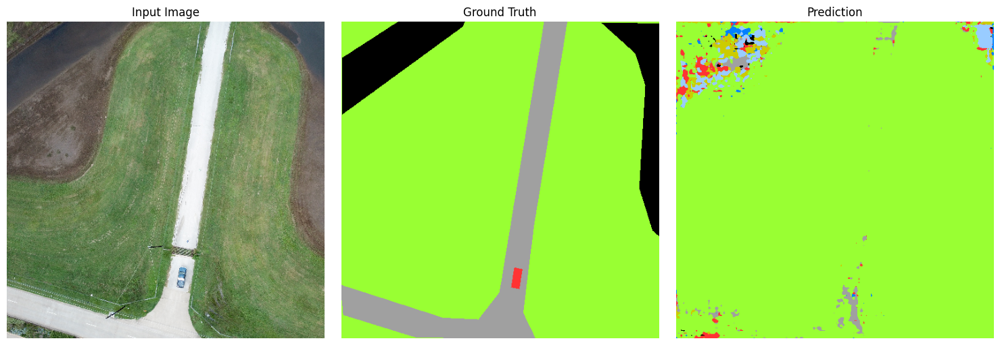

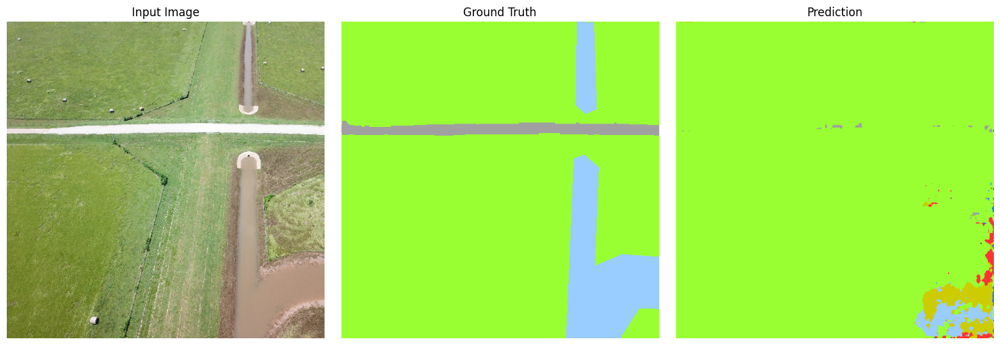

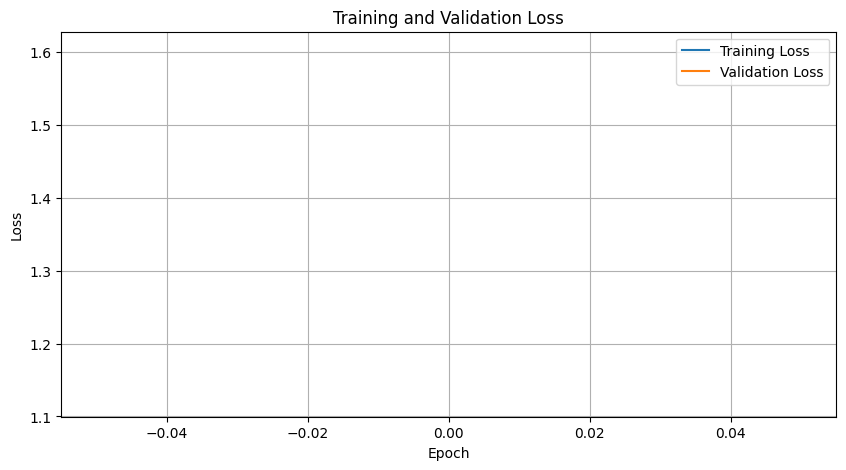

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 2/25 - 39.11s
Training Loss: 0.8834
Validation Loss: 0.6209
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 3/25 - 38.16s
Training Loss: 0.5994
Validation Loss: 0.4154
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 4/25 - 38.48s
Training Loss: 0.4686
Validation Loss: 0.3160
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 5/25 - 38.31s
Training Loss: 0.3970
Validation Loss: 0.2760
Saved best model checkpoint
Visualizing predictions after Epoch 5


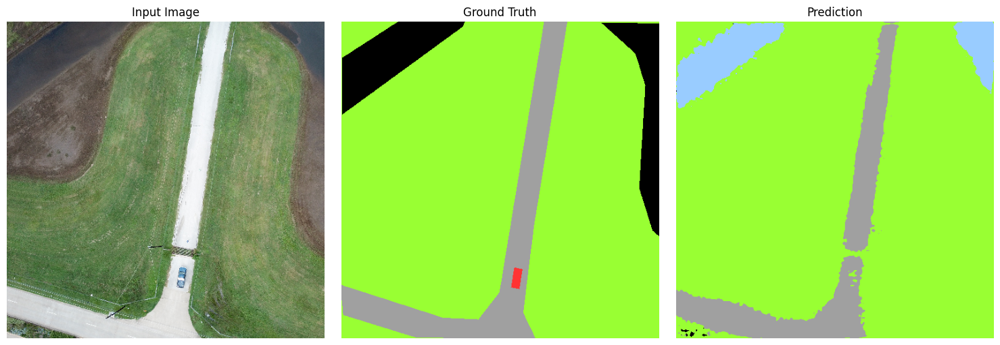

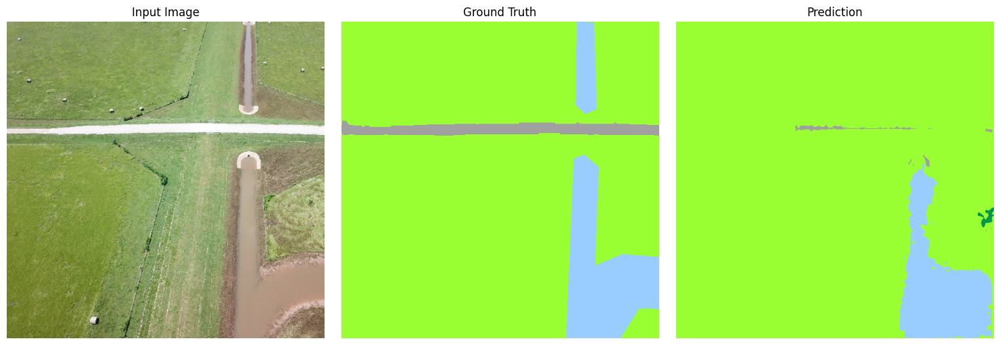

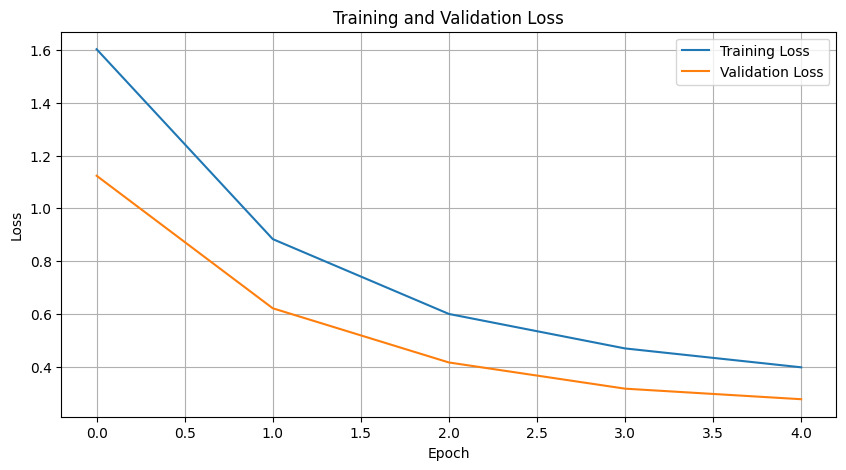

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 6/25 - 38.88s
Training Loss: 0.3394
Validation Loss: 0.2434
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 7/25 - 38.40s
Training Loss: 0.3009
Validation Loss: 0.2137
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 8/25 - 38.54s
Training Loss: 0.2916
Validation Loss: 0.2071
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 9/25 - 38.70s
Training Loss: 0.2815
Validation Loss: 0.2030
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 10/25 - 38.88s
Training Loss: 0.2511
Validation Loss: 0.1942
Saved best model checkpoint
Visualizing predictions after Epoch 10


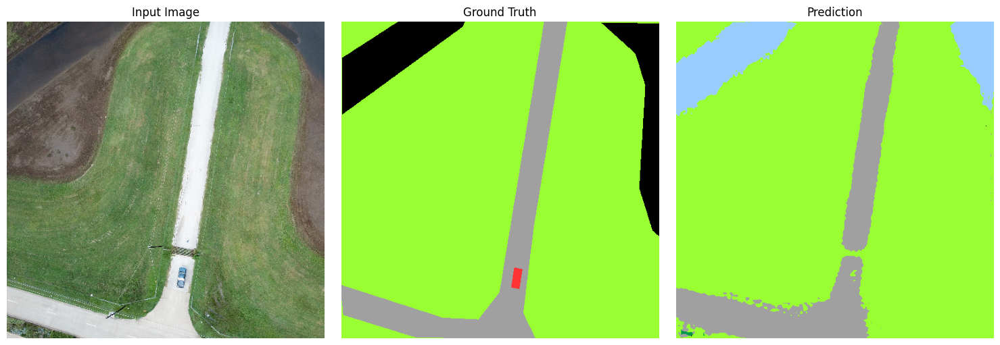

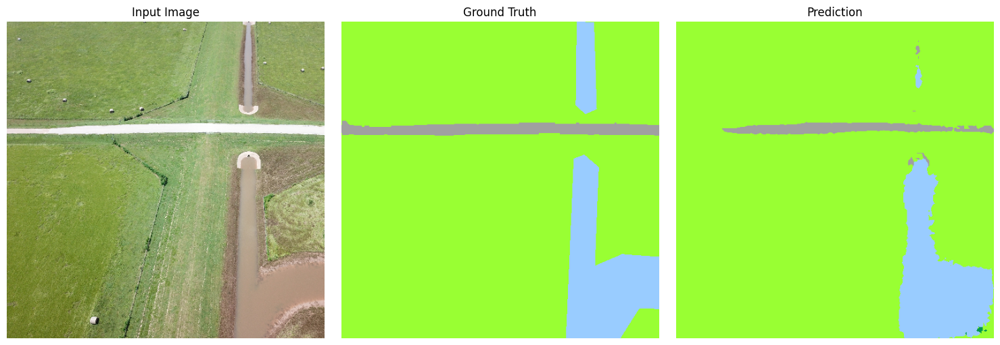

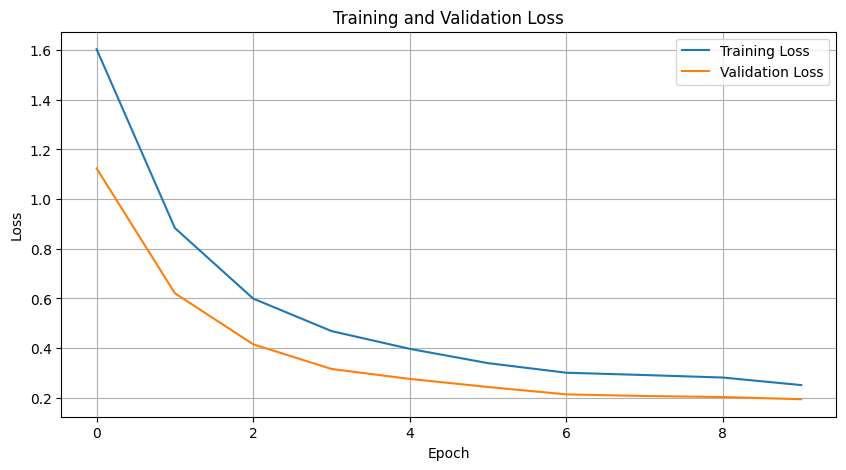

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 11/25 - 38.10s
Training Loss: 0.2452
Validation Loss: 0.1927
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 12/25 - 38.70s
Training Loss: 0.2389
Validation Loss: 0.1838
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 13/25 - 39.13s
Training Loss: 0.2212
Validation Loss: 0.1785
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 14/25 - 38.57s
Training Loss: 0.2217
Validation Loss: 0.1796


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 15/25 - 38.25s
Training Loss: 0.2145
Validation Loss: 0.1835
Visualizing predictions after Epoch 15


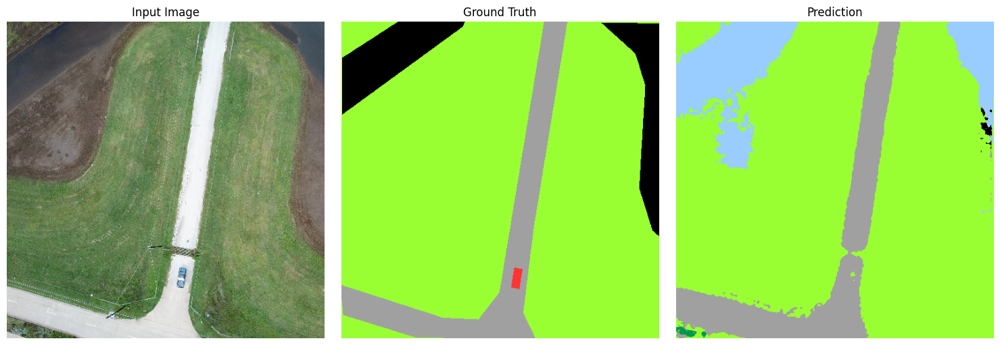

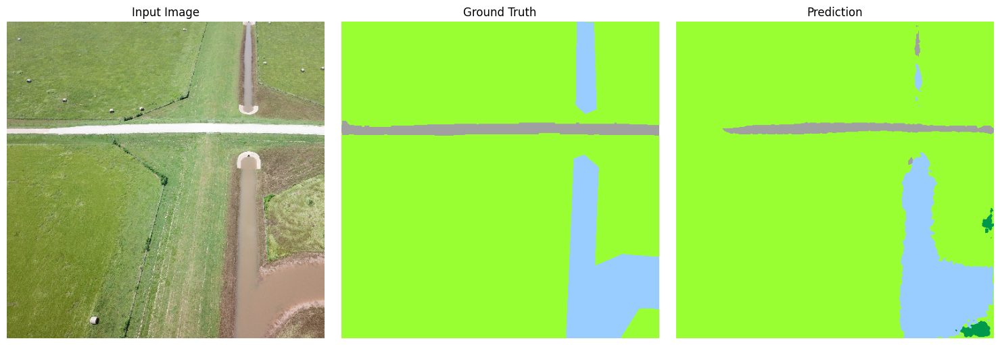

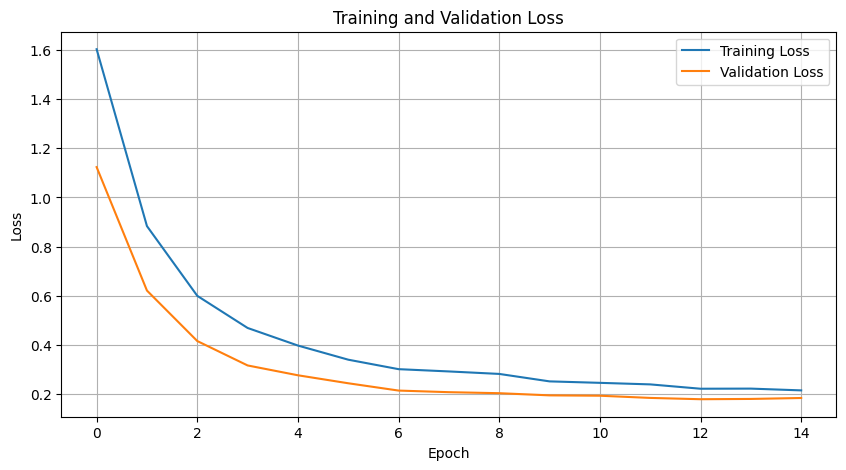

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 16/25 - 38.98s
Training Loss: 0.2040
Validation Loss: 0.1815


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 17/25 - 38.72s
Training Loss: 0.2036
Validation Loss: 0.1779
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 18/25 - 38.68s
Training Loss: 0.1915
Validation Loss: 0.1783


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 19/25 - 38.52s
Training Loss: 0.1858
Validation Loss: 0.1719
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 20/25 - 39.04s
Training Loss: 0.1916
Validation Loss: 0.1748
Visualizing predictions after Epoch 20


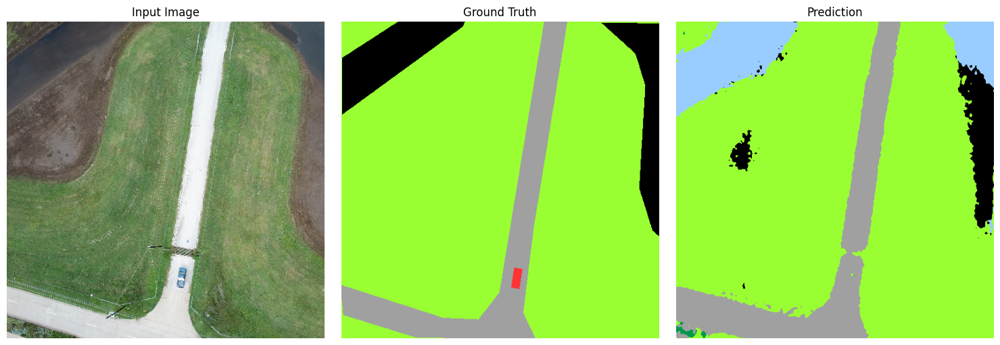

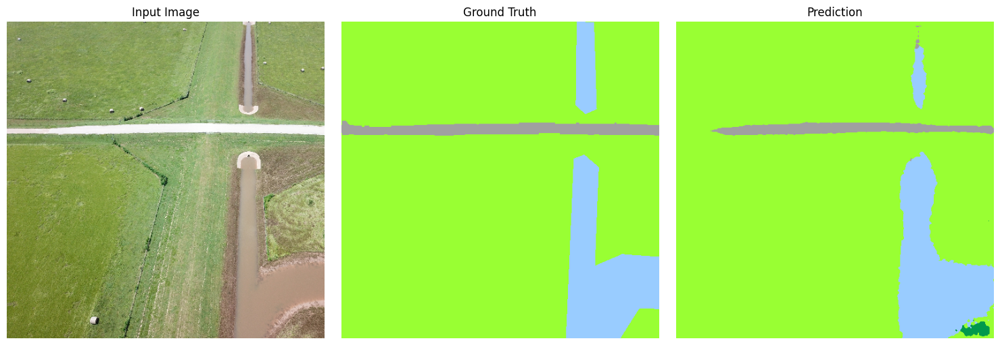

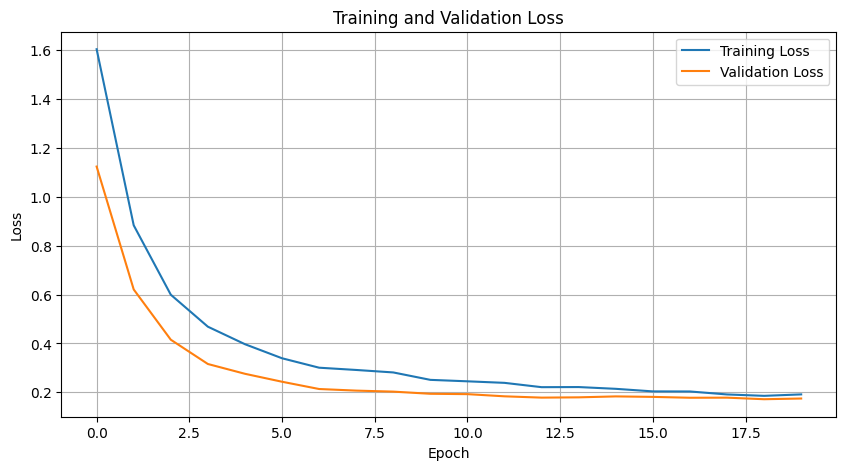

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 21/25 - 38.04s
Training Loss: 0.1816
Validation Loss: 0.1705
Saved best model checkpoint


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 22/25 - 38.84s
Training Loss: 0.1770
Validation Loss: 0.1793


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 23/25 - 38.16s
Training Loss: 0.1772
Validation Loss: 0.1810


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 24/25 - 39.38s
Training Loss: 0.1668
Validation Loss: 0.1711


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 25/25 - 38.20s
Training Loss: 0.1597
Validation Loss: 0.1890
Visualizing predictions after Epoch 25


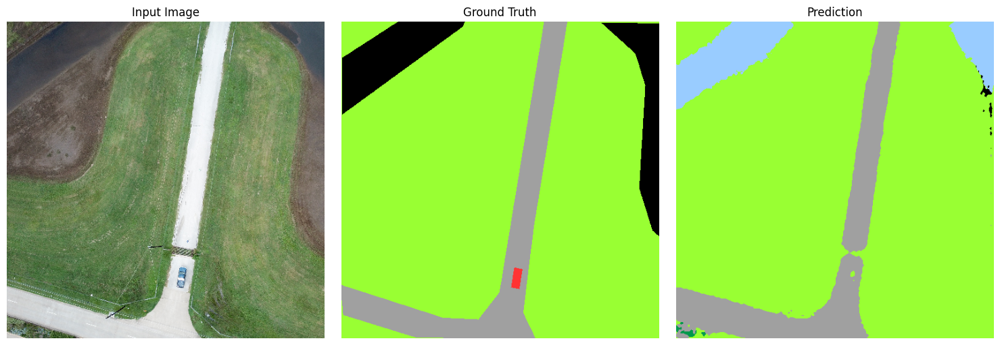

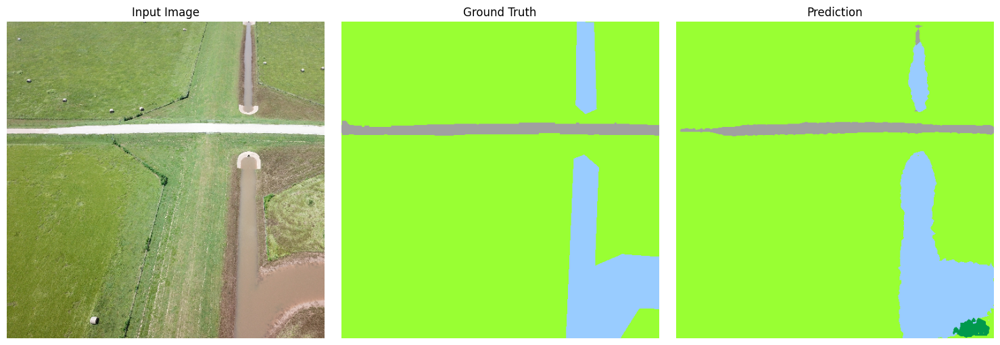

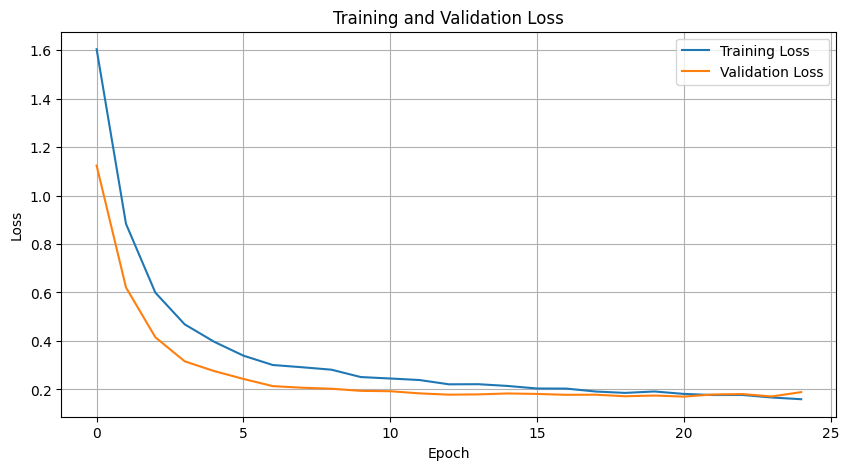

/tmp/ipykernel_140/2294960320.py:40: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('best_segmentation_model.pth'))


In [20]:
segmentation_model, seg_train_losses, seg_val_losses = train_segmentation_model(
segmentation_model, Config.NUM_EPOCHS, train_loader, val_loader, criterion, optimizer
)

In [21]:
# -------------- COMPUTE METRICS --------------

def compute_dice_scores(model, dataloader, device, num_classes):
    model.eval()
    dice_scores = np.zeros(num_classes)
    class_counts = np.zeros(num_classes)
    
    with torch.no_grad():
        for images, masks in tqdm(dataloader, desc="Computing Dice scores"):
            images, masks = images.to(device), masks.to(device)
            
            outputs = model(images)
            predictions = torch.argmax(outputs, dim=1)
            
            # Calculate Dice score for each class
            for cls in range(num_classes):
                pred_mask = (predictions == cls).cpu().numpy()
                gt_mask = (masks == cls).cpu().numpy()
                
                # Count images that have this class
                has_class = np.any(gt_mask, axis=(1, 2))
                class_counts[cls] += np.sum(has_class)
                
                # Calculate Dice for each image
                for i in range(images.size(0)):
                    if has_class[i]:
                        pred = pred_mask[i]
                        gt = gt_mask[i]
                        
                        intersection = np.logical_and(pred, gt).sum()
                        union = pred.sum() + gt.sum()
                        
                        if union > 0:
                            dice_scores[cls] += (2 * intersection / union)
    
    # Average Dice scores
    for cls in range(num_classes):
        if class_counts[cls] > 0:
            dice_scores[cls] /= class_counts[cls]
    
    # Calculate mean Dice score
    valid_classes = class_counts > 0
    mean_dice = np.mean(dice_scores[valid_classes])
    
    return mean_dice, dice_scores

In [22]:
 mean_dice, class_dice_scores = compute_dice_scores(
     segmentation_model, val_loader, Config.DEVICE, Config.NUM_CLASSES
 )
 print(f"Mean Dice Score: {mean_dice:.4f}")
 for cls in range(Config.NUM_CLASSES):
     print(f"Class {cls} Dice Score: {class_dice_scores[cls]:.4f}")

Computing Dice scores:   0%|          | 0/8 [00:00<?, ?it/s]

Mean Dice Score: 0.4246
Class 0 Dice Score: 0.0000
Class 1 Dice Score: 0.5070
Class 2 Dice Score: 0.4201
Class 3 Dice Score: 0.2399
Class 4 Dice Score: 0.7877
Class 5 Dice Score: 0.7188
Class 6 Dice Score: 0.6794
Class 7 Dice Score: 0.0000
Class 8 Dice Score: 0.0004
Class 9 Dice Score: 0.8924
Class 10 Dice Score: 0.0000


In [23]:
print("\n" + "="*50)
print("BINARY FLOOD CLASSIFICATION WITH EFFICIENTNET")
print("="*50 + "\n")


BINARY FLOOD CLASSIFICATION WITH EFFICIENTNET



In [24]:
# -------------- CLASSIFICATION DATASET --------------

class FloodClassificationDataset(Dataset):
    def __init__(self, dataframe, transform=None, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
        self.dataframe = dataframe
        self.transform = transform
        self.mean = mean
        self.std = std
    
    def __len__(self):
        return len(self.dataframe)
    
    def __getitem__(self, idx):
        row = self.dataframe.iloc[idx]
        
        # Load and preprocess image
        img = preprocess_image(row['image_path'])
        
        # Get label (is_flooded)
        label = row['is_flooded']
        
        # Apply transformations if specified
        if self.transform is not None:
            augmented = self.transform(image=img)
            img = augmented['image']
        
        # Convert to tensor and normalize
        img = Image.fromarray(img)
        t = T.Compose([T.ToTensor(), T.Normalize(self.mean, self.std)])
        img = t(img)
        
        return img, torch.tensor(label, dtype=torch.long)

In [25]:
# -------------- CLASSIFICATION CONFIG --------------

class ClassificationConfig:
    IMAGE_SIZE = (384, 384)
    BATCH_SIZE = 8
    NUM_CLASSES = 2  # Binary classification: flooded or non-flooded
    LEARNING_RATE = 1e-4
    NUM_EPOCHS = 15
    EFFICIENTNET_VERSION = 'b0'
    DEVICE = Config.DEVICE

In [26]:
# -------------- CLASSIFICATION TRANSFORMATIONS --------------

classification_train_transforms = A.Compose([
    A.Resize(ClassificationConfig.IMAGE_SIZE[0], ClassificationConfig.IMAGE_SIZE[1]),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.3),
    A.ShiftScaleRotate(p=0.3)
])

classification_val_transforms = A.Compose([
    A.Resize(ClassificationConfig.IMAGE_SIZE[0], ClassificationConfig.IMAGE_SIZE[1])
])

In [27]:
# -------------- CLASSIFICATION DATASETS & DATALOADERS --------------

class_train_dataset = FloodClassificationDataset(X_train, transform=classification_train_transforms, mean=mean, std=std)
class_val_dataset = FloodClassificationDataset(X_val, transform=classification_val_transforms, mean=mean, std=std)

class_train_loader = DataLoader(
    class_train_dataset,
    batch_size=ClassificationConfig.BATCH_SIZE,
    shuffle=True,
    num_workers=4
)

class_val_loader = DataLoader(
    class_val_dataset,
    batch_size=ClassificationConfig.BATCH_SIZE,
    shuffle=False,
    num_workers=4
)

In [28]:
# -------------- CLASSIFICATION MODEL --------------

class FloodClassifier(nn.Module):
    """Binary classifier based on EfficientNet"""
    
    def __init__(self, model_name='efficientnet-b0', num_classes=2, pretrained=True):
        super(FloodClassifier, self).__init__()
        
        # Load pre-trained EfficientNet
        self.model = EfficientNet.from_pretrained(model_name) if pretrained else EfficientNet.from_name(model_name)
        
        # Replace final fully connected layer
        feature_dims = self.model._fc.in_features
        self.model._fc = nn.Sequential(
            nn.Dropout(0.3),  # Add dropout for regularization
            nn.Linear(feature_dims, num_classes)
        )
    
    def forward(self, x):
        return self.model(x)

In [29]:
# Initialize classification model
flood_classifier = FloodClassifier(
    model_name=f'efficientnet-{ClassificationConfig.EFFICIENTNET_VERSION}',
    num_classes=ClassificationConfig.NUM_CLASSES,
    pretrained=True
)
flood_classifier = flood_classifier.to(ClassificationConfig.DEVICE)

# Define loss function and optimizer
classification_criterion = nn.CrossEntropyLoss()
classification_optimizer = torch.optim.Adam(
    flood_classifier.parameters(), 
    lr=ClassificationConfig.LEARNING_RATE
)
classification_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    classification_optimizer, 
    mode='min', 
    factor=0.5, 
    patience=3, 
    verbose=True
)

Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b0-355c32eb.pth" to /root/.cache/torch/hub/checkpoints/efficientnet-b0-355c32eb.pth
100%|██████████| 20.4M/20.4M [00:00<00:00, 26.7MB/s]

Loaded pretrained weights for efficientnet-b0



/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


In [30]:
# -------------- CLASSIFICATION TRAINING FUNCTIONS --------------

def train_classification_epoch(model, loader, criterion, optimizer, device):
    """Train the classification model for one epoch"""
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0
    
    for images, labels in tqdm(loader, desc="Training"):
        images, labels = images.to(device), labels.to(device)
        
        # Forward pass
        outputs = model(images)
        loss = criterion(outputs, labels)
        
        # Backward pass and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        # Track statistics
        running_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
    
    epoch_loss = running_loss / len(loader)
    epoch_acc = 100.0 * correct / total
    
    return epoch_loss, epoch_acc

def evaluate_classification(model, loader, criterion, device):
    """Evaluate the classification model"""
    model.eval()
    running_loss = 0.0
    correct = 0
    total = 0
    
    with torch.no_grad():
        for images, labels in tqdm(loader, desc="Evaluating"):
            images, labels = images.to(device), labels.to(device)
            
            # Forward pass
            outputs = model(images)
            loss = criterion(outputs, labels)
            
            # Track statistics
            running_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    
    epoch_loss = running_loss / len(loader)
    epoch_acc = 100.0 * correct / total
    
    return epoch_loss, epoch_acc

def visualize_classification_predictions(model, loader, device, num_samples=6):
    """Visualize model predictions"""
    model.eval()
    all_images = []
    all_labels = []
    all_preds = []
    
    with torch.no_grad():
        for images, labels in loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, preds = torch.max(outputs, 1)
            
            # Add to lists
            all_images.extend(images.cpu())
            all_labels.extend(labels.cpu())
            all_preds.extend(preds.cpu())
            
            if len(all_images) >= num_samples:
                break
    
    # Create figure
    fig, axes = plt.subplots(2, 3, figsize=(15, 10))
    axes = axes.flatten()
    
    for i in range(min(num_samples, len(all_images))):
        # Convert tensor to image
        img = all_images[i].permute(1, 2, 0).numpy()
        # Denormalize
        img = img * np.array(std) + np.array(mean)
        img = np.clip(img, 0, 1)
        
        # Get prediction and label
        pred = "Flooded" if all_preds[i] == 1 else "Non-Flooded"
        label = "Flooded" if all_labels[i] == 1 else "Non-Flooded"
        title = f"Pred: {pred}\nTrue: {label}"
        color = "green" if all_preds[i] == all_labels[i] else "red"
        
        # Display
        axes[i].imshow(img)
        axes[i].set_title(title, color=color)
        axes[i].axis('off')
    
    plt.tight_layout()
    plt.show()

def plot_classification_metrics(train_losses, val_losses, train_accs, val_accs):
    """Plot training and validation metrics"""
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    
    # Plot loss
    ax1.plot(train_losses, label='Training Loss')
    ax1.plot(val_losses, label='Validation Loss')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss')
    ax1.set_title('Training and Validation Loss')
    ax1.legend()
    ax1.grid(True)
    
    # Plot accuracy
    ax2.plot(train_accs, label='Training Accuracy')
    ax2.plot(val_accs, label='Validation Accuracy')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Accuracy (%)')
    ax2.set_title('Training and Validation Accuracy')
    ax2.legend()
    ax2.grid(True)
    
    plt.tight_layout()
    plt.show()

In [31]:
# -------------- TRAIN CLASSIFICATION MODEL --------------

def train_classification_model(model, num_epochs, train_loader, val_loader, criterion, optimizer, scheduler):
    train_losses = []
    val_losses = []
    train_accs = []
    val_accs = []
    best_val_acc = 0.0
    
    for epoch in range(num_epochs):
        start_time = time.time()
        
        # Train for one epoch
        train_loss, train_acc = train_classification_epoch(
            model, train_loader, criterion, optimizer, ClassificationConfig.DEVICE
        )
        
        # Evaluate
        val_loss, val_acc = evaluate_classification(
            model, val_loader, criterion, ClassificationConfig.DEVICE
        )
        
        # Update learning rate
        scheduler.step(val_loss)
        
        # Record metrics
        train_losses.append(train_loss)
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)
        
        # Print epoch results
        epoch_time = time.time() - start_time
        print(f"Epoch {epoch+1}/{num_epochs} - {epoch_time:.2f}s")
        print(f"Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.2f}%")
        print(f"Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.2f}%")
        
        # Save best model
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            torch.save(model.state_dict(), 'best_flood_classifier.pth')
            print(f"New best model saved with validation accuracy: {val_acc:.2f}%")
        
        # Visualize predictions every 5 epochs
        if (epoch + 1) % 5 == 0 or epoch == 0:
            visualize_classification_predictions(
                model, val_loader, ClassificationConfig.DEVICE
            )
            plot_classification_metrics(
                train_losses, val_losses, train_accs, val_accs
            )
    
    # Load best model
    model.load_state_dict(torch.load('best_flood_classifier.pth'))
    return model, train_losses, val_losses, train_accs, val_accs

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 1/15 - 27.83s
Train Loss: 0.4620, Train Acc: 84.02%
Val Loss: 0.4721, Val Acc: 83.33%
New best model saved with validation accuracy: 83.33%


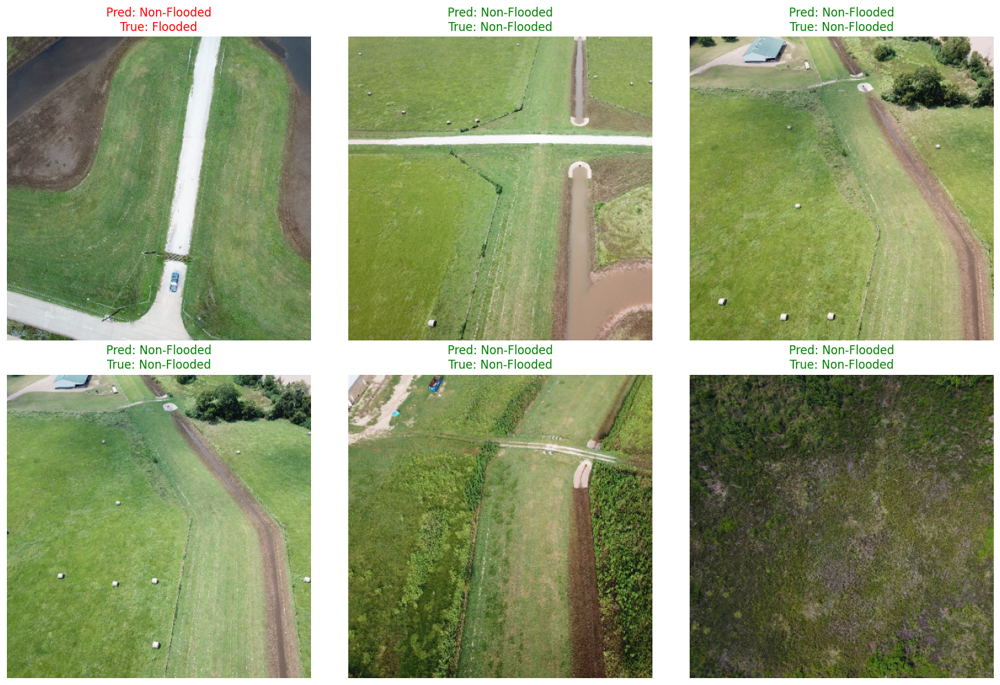

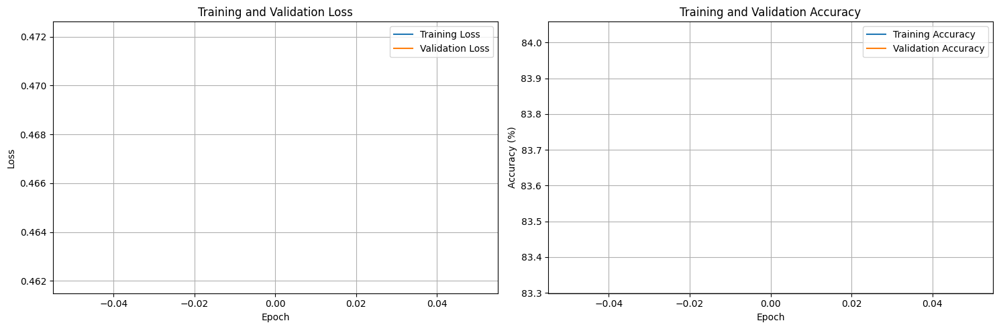

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 2/15 - 27.64s
Train Loss: 0.2332, Train Acc: 94.08%
Val Loss: 0.3561, Val Acc: 88.33%
New best model saved with validation accuracy: 88.33%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 3/15 - 27.73s
Train Loss: 0.1415, Train Acc: 95.86%
Val Loss: 0.2689, Val Acc: 93.33%
New best model saved with validation accuracy: 93.33%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 4/15 - 27.81s
Train Loss: 0.1114, Train Acc: 97.34%
Val Loss: 0.2548, Val Acc: 93.33%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 5/15 - 27.39s
Train Loss: 0.1242, Train Acc: 96.75%
Val Loss: 0.2131, Val Acc: 95.00%
New best model saved with validation accuracy: 95.00%


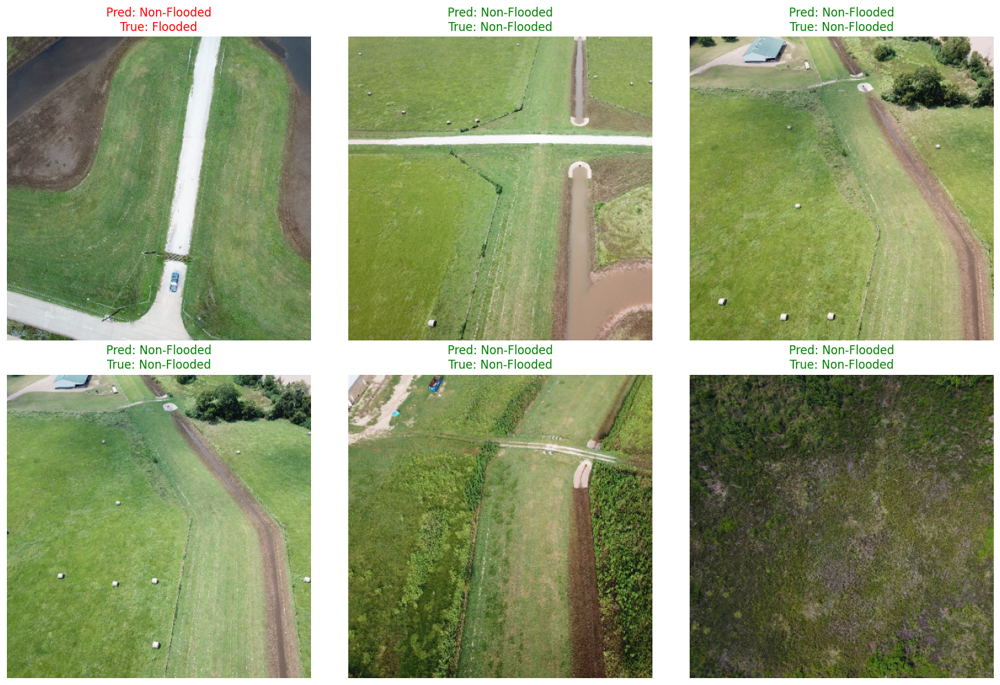

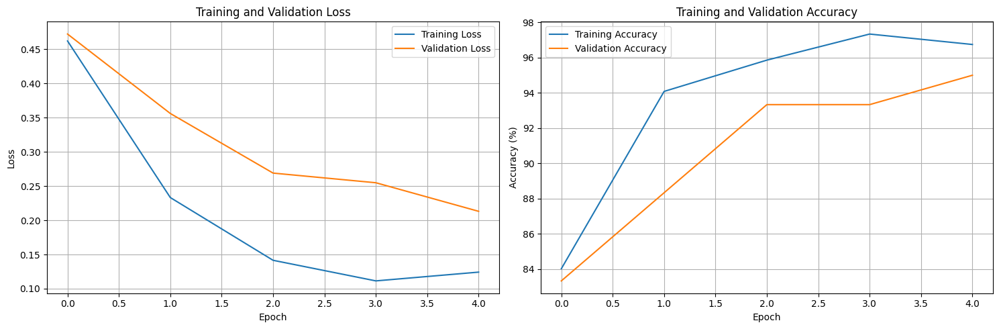

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 6/15 - 27.35s
Train Loss: 0.0837, Train Acc: 98.82%
Val Loss: 0.1921, Val Acc: 96.67%
New best model saved with validation accuracy: 96.67%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 7/15 - 27.28s
Train Loss: 0.0680, Train Acc: 98.22%
Val Loss: 0.2004, Val Acc: 96.67%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 8/15 - 27.17s
Train Loss: 0.0587, Train Acc: 98.22%
Val Loss: 0.1798, Val Acc: 96.67%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 9/15 - 27.55s
Train Loss: 0.0639, Train Acc: 97.93%
Val Loss: 0.1863, Val Acc: 96.67%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 10/15 - 27.69s
Train Loss: 0.0411, Train Acc: 98.52%
Val Loss: 0.1841, Val Acc: 96.67%


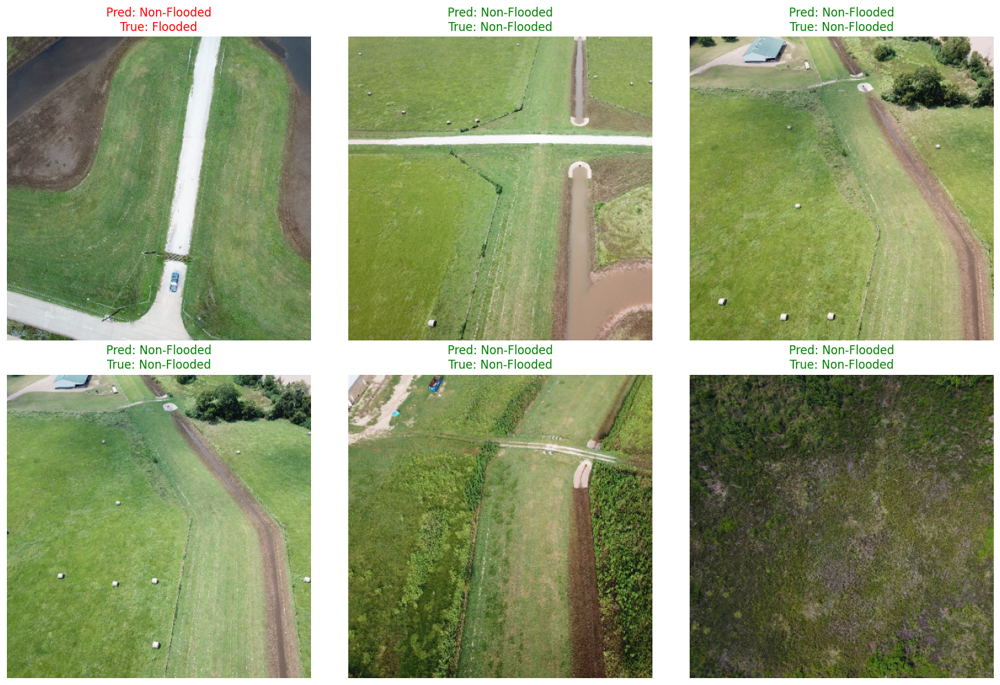

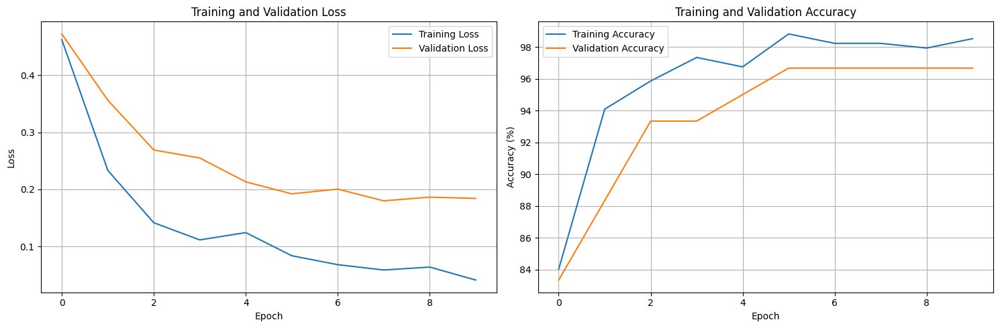

Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 11/15 - 27.82s
Train Loss: 0.0461, Train Acc: 98.52%
Val Loss: 0.2096, Val Acc: 96.67%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 12/15 - 27.50s
Train Loss: 0.1211, Train Acc: 98.82%
Val Loss: 0.1736, Val Acc: 96.67%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 13/15 - 27.70s
Train Loss: 0.0512, Train Acc: 98.82%
Val Loss: 0.1613, Val Acc: 96.67%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 14/15 - 27.42s
Train Loss: 0.0298, Train Acc: 99.41%
Val Loss: 0.1718, Val Acc: 96.67%


Training:   0%|          | 0/43 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/8 [00:00<?, ?it/s]

Epoch 15/15 - 27.01s
Train Loss: 0.0269, Train Acc: 99.11%
Val Loss: 0.1472, Val Acc: 93.33%


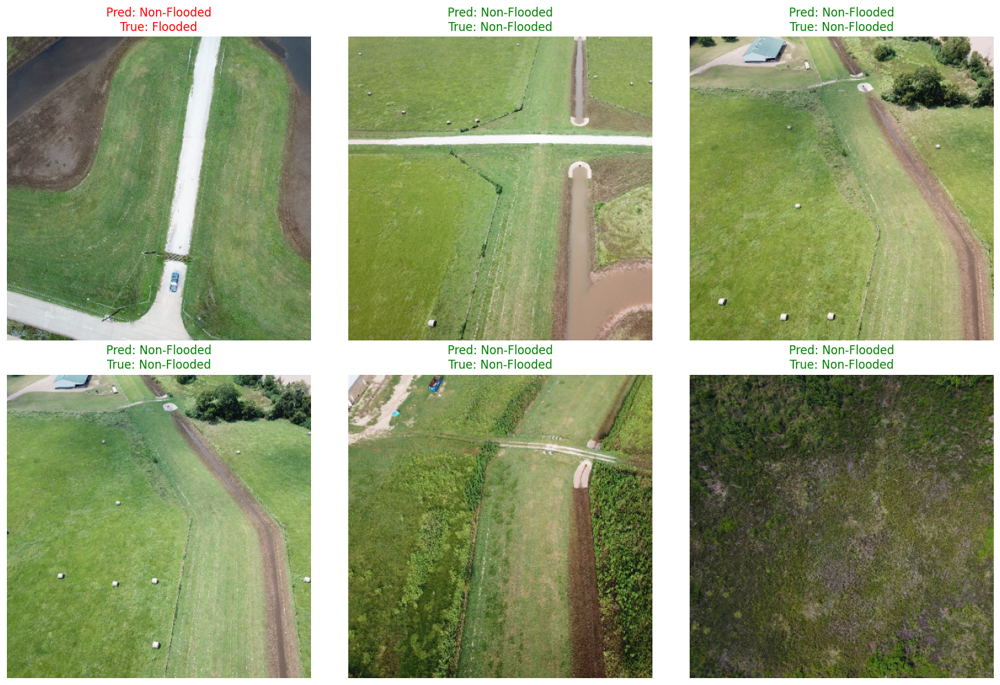

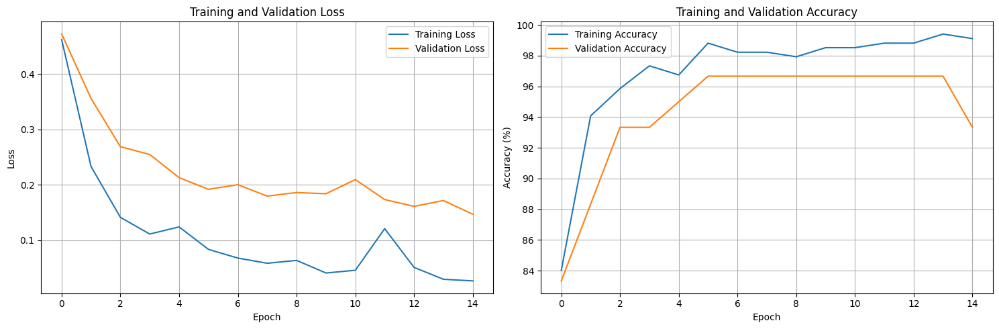

/tmp/ipykernel_140/2435253641.py:54: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('best_flood_classifier.pth'))


In [32]:
 flood_classifier, class_train_losses, class_val_losses, class_train_accs, class_val_accs = train_classification_model(
     flood_classifier, 
     ClassificationConfig.NUM_EPOCHS, 
     class_train_loader, 
     class_val_loader, 
     classification_criterion, 
     classification_optimizer,
     classification_scheduler
 )

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

def generate_classification_metrics(model, loader, device):
    """Generate classification metrics"""
    model.eval()
    all_preds = []
    all_labels = []
    
    with torch.no_grad():
        for images, labels in tqdm(loader, desc="Generating metrics"):
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, preds = torch.max(outputs, 1)
            
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    # Calculate metrics
    cm = confusion_matrix(all_labels, all_preds)
    report = classification_report(all_labels, all_preds, target_names=["Non-Flooded", "Flooded"])
    accuracy = accuracy_score(all_labels, all_preds)
    
    return cm, report, accuracy

def plot_confusion_matrix(cm, class_names):
    """Plot the confusion matrix using Seaborn heatmap"""
    plt.figure(figsize=(6, 5))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.tight_layout()
    plt.show()




Generating metrics:   0%|          | 0/8 [00:00<?, ?it/s]

Accuracy: 96.67%

Classification Report:
               precision    recall  f1-score   support

 Non-Flooded       0.96      1.00      0.98        52
     Flooded       1.00      0.75      0.86         8

    accuracy                           0.97        60
   macro avg       0.98      0.88      0.92        60
weighted avg       0.97      0.97      0.96        60



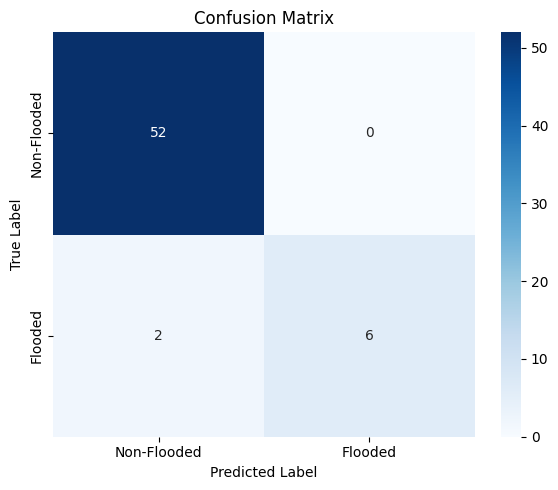

In [34]:
cm, report, accuracy = generate_classification_metrics(flood_classifier, class_val_loader, ClassificationConfig.DEVICE)
print(f"Accuracy: {accuracy*100:.2f}%")
print("\nClassification Report:\n", report)
plot_confusion_matrix(cm, ["Non-Flooded", "Flooded"])

In [35]:
print("\n" + "="*50)
print("VISUAL QUESTION ANSWERING (VQA)")
print("="*50 + "\n")



VISUAL QUESTION ANSWERING (VQA)



In [36]:
import os
import json
import gc
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torchvision.models as models
from PIL import Image
from nltk.tokenize import word_tokenize
from tqdm import tqdm

In [37]:
os.environ['PYTORCH_CUDA_ALLOC_CONF'] = 'expandable_segments:True'
torch.cuda.empty_cache()
gc.collect()

# Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

if torch.cuda.is_available():
    print(f"Using GPU: {torch.cuda.get_device_name(0)}")
    print(f"Total GPU memory: {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB")
    print(f"Available GPU memory: {torch.cuda.memory_reserved(0) / 1e9:.2f} GB")
else:
    print("GPU not available, using CPU")


Using device: cuda
Using GPU: Tesla P100-PCIE-16GB
Total GPU memory: 17.06 GB
Available GPU memory: 0.25 GB


In [38]:
# Add at the beginning of your script
import os
import torch

# Force CUDA to be visible
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"

# Clear GPU cache
torch.cuda.empty_cache()

# Set device with explicit check
if torch.cuda.is_available():
    device = torch.device('cuda')
    print(f"Using GPU: {torch.cuda.get_device_name(0)}")
    print(f"CUDA Version: {torch.version.cuda}")
    print(f"PyTorch CUDA available: {torch.cuda.is_available()}")
    print(f"Number of CUDA devices: {torch.cuda.device_count()}")
    print(f"Current CUDA device: {torch.cuda.current_device()}")
    print(f"GPU Memory: {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB")
else:
    device = torch.device('cpu')
    print("WARNING: No GPU available, using CPU instead")

# Enable cuDNN benchmarking for better performance
torch.backends.cudnn.benchmark = True

Using GPU: Tesla P100-PCIE-16GB
CUDA Version: 12.4
PyTorch CUDA available: True
Number of CUDA devices: 1
Current CUDA device: 0
GPU Memory: 17.06 GB


In [39]:
# Dataset class
class FloodNetVQADataset(Dataset):
    def __init__(self, data_dir, question_file, split='train', max_question_len=20, transform=None):
        """
        FloodNet VQA Dataset loader
        
        Args:
            data_dir: Root directory of the dataset
            question_file: Path to the question JSON file
            split: 'train', 'valid', or 'test'
            max_question_len: Maximum length of questions
            transform: Image transformations
        """
        self.data_dir = data_dir
        self.split = split
        self.max_question_len = max_question_len
        
        # Set default transform if none provided
        if transform is None:
            self.transform = transforms.Compose([
                transforms.Resize((224, 224)),
                transforms.ToTensor(),
                transforms.Normalize(mean=[0.485, 0.456, 0.406], 
                             std=[0.229, 0.224, 0.225])
            ])
        else:
            self.transform = transform
            
        # Load questions
        question_path = os.path.join(data_dir, 'Questions', question_file)
        print(f"Loading questions from: {question_path}")
        
        with open(question_path, 'r') as f:
            # Try to parse the JSON structure
            try:
                json_data = json.load(f)
                
                # Handle the specific structure with "root" key
                if "root" in json_data:
                    # Convert the nested dictionary to a list
                    self.questions = []
                    for key, value in json_data["root"].items():
                        if isinstance(value, dict):
                            self.questions.append(value)
                else:
                    # Try other formats
                    self.questions = []
                    for key, value in json_data.items():
                        if isinstance(value, dict):
                            self.questions.append(value)
            except json.JSONDecodeError:
                # If JSON parsing fails, try to read line by line
                f.seek(0)  # Go back to the beginning of the file
                self.questions = []
                for line in f:
                    try:
                        q_data = json.loads(line.strip())
                        self.questions.append(q_data)
                    except:
                        continue
        
        # Print a sample to debug
        if len(self.questions) > 0:
            print(f"Sample question data: {self.questions[0]}")
            print(f"Total questions loaded: {len(self.questions)}")
        else:
            print("Warning: No questions loaded!")
                
        # Create vocabulary (first pass to collect all words)
        self.build_vocab()
        
        # Image directory based on split
        if split == 'train':
            self.img_dir = os.path.join(data_dir, 'Images', 'Train_Image')
        elif split == 'valid':
            self.img_dir = os.path.join(data_dir, 'Images', 'Valid_Image')
        else:  # test
            self.img_dir = os.path.join(data_dir, 'Images', 'Test_Image')
            
    def build_vocab(self):
        """Build vocabulary from the questions"""
        word_count = {}
        
        # Count word occurrences
        for q_data in self.questions:
            # Check if q_data has the 'Question' key (based on your JSON structure)
            if isinstance(q_data, dict) and 'Question' in q_data:
                question = q_data['Question']
            elif isinstance(q_data, dict) and 'question' in q_data:
                question = q_data['question']
            else:
                # Skip this item if no question found
                continue
            
            # Ensure question is a string
            if not isinstance(question, str):
                continue
                
            tokens = word_tokenize(question.lower())
            for token in tokens:
                if token in word_count:
                    word_count[token] += 1
                else:
                    word_count[token] = 1
        
        # Create vocabulary (words that appear at least 5 times)
        vocab = {'<pad>': 0, '<unk>': 1}
        for word, count in word_count.items():
            if count >= 5:
                vocab[word] = len(vocab)
                
        self.vocab = vocab
        self.vocab_size = len(vocab)
        
        # Create answer vocabulary
        ans_vocab = {}
        for q_data in self.questions:
            # Check for answer in different possible keys
            answer = None
            if 'Ground_Truth' in q_data:
                answer = q_data['Ground_Truth']
            elif 'answer' in q_data:
                answer = q_data['answer']
            elif 'Answer' in q_data:
                answer = q_data['Answer']
                
            if answer:
                if answer in ans_vocab:
                    ans_vocab[answer] += 1
                else:
                    ans_vocab[answer] = 1
        
        # Keep only answers that appear at least 3 times
        self.ans_to_idx = {}
        for ans, count in ans_vocab.items():
            if count >= 3:
                self.ans_to_idx[ans] = len(self.ans_to_idx)
        
        self.num_classes = len(self.ans_to_idx)
        print(f"Vocabulary size: {self.vocab_size}, Number of answer classes: {self.num_classes}")
        
    def tokenize_question(self, question):
        """Tokenize and pad/truncate question"""
        tokens = word_tokenize(question.lower())
        question_vec = []
        
        for token in tokens:
            if token in self.vocab:
                question_vec.append(self.vocab[token])
            else:
                question_vec.append(self.vocab['<unk>'])
                
        # Pad or truncate
        if len(question_vec) < self.max_question_len:
            question_vec += [self.vocab['<pad>']] * (self.max_question_len - len(question_vec))
        else:
            question_vec = question_vec[:self.max_question_len]
            
        return torch.tensor(question_vec, dtype=torch.long)
    
    def __len__(self):
        return len(self.questions)
    
    def __getitem__(self, idx):
        q_data = self.questions[idx]
        
        # Handle the specific JSON structure
        image_id = q_data.get('Image_ID', q_data.get('image_id', ''))
        question = q_data.get('Question', q_data.get('question', ''))
        answer = q_data.get('Ground_Truth', q_data.get('answer', ''))
        
        # Load and transform image
        img_path = os.path.join(self.img_dir, image_id)
        try:
            image = Image.open(img_path).convert('RGB')
            image = self.transform(image)
        except Exception as e:
            print(f"Error loading image {img_path}: {e}")
            # Create a blank image as fallback
            image = torch.zeros(3, 224, 224)
        
        # Process question
        q_vec = self.tokenize_question(question)
        
        # For training and validation, also return answer
        if self.split in ['train', 'valid'] and answer:
            if answer in self.ans_to_idx:
                a_idx = self.ans_to_idx[answer]
            else:
                # Instead of -1, use a valid index (0) for unknown answers
                a_idx = 0  # Use the first class as default
                
            # Ensure answer is a tensor with long dtype
            answer_tensor = torch.tensor(a_idx, dtype=torch.long)
            
            return {
                'image': image,
                'question': q_vec,
                'answer': answer_tensor,
                'question_text': question,
                'answer_text': answer
            }
        else:
            # For test set
            return {
                'image': image,
                'question': q_vec,
                'question_text': question,
                'image_id': image_id
            }

In [40]:
# Custom collate function
def custom_collate_fn(batch):
    """
    Custom collate function to handle inconsistent data types
    """
    # Filter out samples with invalid answer indices
    filtered_batch = []
    for item in batch:
        if 'answer' in item and not isinstance(item['answer'], torch.Tensor):
            # Convert to tensor if it's not already
            item['answer'] = torch.tensor(0, dtype=torch.long)  # Default to class 0
        filtered_batch.append(item)
    
    # Group items by keys
    elem = filtered_batch[0]
    batch_dict = {key: [d[key] for d in filtered_batch] for key in elem}
    
    # Process each key
    result = {}
    for key, values in batch_dict.items():
        if key in ['image', 'question', 'answer']:
            # These should be tensors
            result[key] = torch.stack(values)
        else:
            # Text fields remain as lists
            result[key] = values
    
    return result

In [41]:
# Data loader function
def get_loader(data_dir, batch_size=4, split='train', shuffle=True, num_workers=0):
    """Returns data loader for FloodNet VQA dataset with memory optimizations"""
    
    # Determine question file based on split
    if split == 'train':
        question_file = 'Training Question.json'
    elif split == 'valid':
        question_file = 'Valid Question.json'
    else:  # test
        question_file = 'Test_Question.json'
    
    dataset = FloodNetVQADataset(
        data_dir=data_dir,
        question_file=question_file,
        split=split
    )
    
    # Use pin_memory=False to reduce memory pressure
    data_loader = DataLoader(
        dataset=dataset,
        batch_size=batch_size,
        shuffle=shuffle,
        num_workers=num_workers,  # Set to 0 to avoid multiprocessing overhead
        pin_memory=False,  # Disable pin_memory to reduce GPU memory usage
        collate_fn=custom_collate_fn
    )
    
    return data_loader, dataset

In [42]:
# Simple VQA model
class SimpleVQA(nn.Module):
    def __init__(self, vocab_size, num_classes, embed_size=256, hidden_size=512):
        """
        A simplified VQA model
        
        Args:
            vocab_size: Size of the question vocabulary
            num_classes: Number of answer classes
            embed_size: Word embedding dimension
            hidden_size: Hidden layer dimension
        """
        super(SimpleVQA, self).__init__()
        
        # Image encoder - using ResNet18 (smaller and faster than VGG/ResNet50)
        resnet = models.resnet18(pretrained=True)
        # Remove the final fully connected layer
        modules = list(resnet.children())[:-1]
        self.image_encoder = nn.Sequential(*modules)
        
        # Freeze the image encoder to save memory and computation
        for param in self.image_encoder.parameters():
            param.requires_grad = False
            
        # Question encoder
        self.embedding = nn.Embedding(vocab_size, embed_size)
        self.question_encoder = nn.LSTM(
            embed_size, 
            hidden_size, 
            batch_first=True
        )
        
        # Fusion and classification
        self.fusion = nn.Sequential(
            nn.Linear(512 + hidden_size, 512),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(512, num_classes)
        )
    
    def forward(self, images, questions):
        """
        Forward pass with explicit GPU memory management
        
        Args:
            images: [batch_size, 3, 224, 224]
            questions: [batch_size, max_question_len]
            
        Returns:
            logits: [batch_size, num_classes]
        """
        # Verify tensors are on the correct device
        if images.device != next(self.parameters()).device:
            images = images.to(next(self.parameters()).device)
        if questions.device != next(self.parameters()).device:
            questions = questions.to(next(self.parameters()).device)
        
        # Extract image features with memory optimization
        with torch.no_grad():  # Don't compute gradients for the image encoder
            img_features = self.image_encoder(images)  # [batch_size, 512, 1, 1]
            img_features = img_features.squeeze(-1).squeeze(-1)  # [batch_size, 512]
        
        # Extract question features
        embedded = self.embedding(questions)  # [batch_size, max_question_len, embed_size]
        _, (hidden, _) = self.question_encoder(embedded)  # [1, batch_size, hidden_size]
        ques_features = hidden.squeeze(0)  # [batch_size, hidden_size]
        
        # Combine features and classify
        combined = torch.cat([img_features, ques_features], dim=1)  # [batch_size, 512+hidden_size]
        logits = self.fusion(combined)
        
        return logits

In [43]:
def train_epoch(model, train_loader, criterion, optimizer, device, accumulation_steps=4):
    """Train for one epoch with memory optimizations and GPU acceleration"""
    model.train()
    train_loss = 0
    train_correct = 0
    train_total = 0
    
    # Reset gradients
    optimizer.zero_grad()
    
    # Enable mixed precision training
    scaler = torch.cuda.amp.GradScaler()
    
    train_progress = tqdm(train_loader, desc="Training")
    for batch_idx, batch in enumerate(train_progress):
        # Move data to device
        images = batch['image'].to(device)
        questions = batch['question'].to(device)
        answers = batch['answer'].to(device)
        
        # Forward pass with mixed precision
        with torch.cuda.amp.autocast():
            outputs = model(images, questions)
            loss = criterion(outputs, answers)
            loss = loss / accumulation_steps
        
        # Backward pass with gradient scaling
        scaler.scale(loss).backward()
        
        # Update weights only after accumulation_steps batches
        if (batch_idx + 1) % accumulation_steps == 0 or (batch_idx + 1) == len(train_loader):
            scaler.step(optimizer)
            scaler.update()
            optimizer.zero_grad()
        
        # Statistics
        train_loss += loss.item() * accumulation_steps
        with torch.no_grad():
            _, predicted = outputs.max(1)
            train_total += answers.size(0)
            train_correct += predicted.eq(answers).sum().item()
        
        # Clear some memory
        del images, questions, outputs, loss
        torch.cuda.empty_cache()
        
        # Update progress bar
        train_progress.set_postfix({
            'loss': train_loss / (batch_idx + 1),
            'acc': 100. * train_correct / train_total if train_total > 0 else 0
        })
    
    return train_loss / len(train_loader), 100. * train_correct / train_total

In [44]:
# Fix the validation function to handle missing answer keys
def validate(model, val_loader, criterion, device):
    """Validate the model with support for datasets without answer labels"""
    model.eval()
    val_loss = 0
    val_correct = 0
    val_total = 0
    
    with torch.no_grad():
        val_progress = tqdm(val_loader, desc="Validation")
        for batch in val_progress:
            images = batch['image'].to(device)
            questions = batch['question'].to(device)
            
            # Check if answers are available
            if 'answer' not in batch:
                # Skip loss calculation for datasets without answers
                outputs = model(images, questions)
                val_progress.set_postfix({'status': 'prediction only (no labels)'})
                continue
                
            answers = batch['answer'].to(device)
            
            # Forward pass
            outputs = model(images, questions)
            loss = criterion(outputs, answers)
            
            # Statistics
            val_loss += loss.item()
            _, predicted = outputs.max(1)
            val_total += answers.size(0)
            val_correct += predicted.eq(answers).sum().item()
            
            # Clear some memory
            del images, questions, outputs
            if 'answer' in batch:
                del answers, loss
            torch.cuda.empty_cache()
            
            # Update progress bar
            if val_total > 0:
                val_progress.set_postfix({
                    'loss': val_loss / (val_progress.n + 1),
                    'acc': 100. * val_correct / val_total
                })
    
    # If no validation samples had answers, return placeholder values
    if val_total == 0:
        return 0.0, 0.0
        
    return val_loss / len(val_loader), 100. * val_correct / val_total

In [45]:
# Update the main function to handle validation sets without answers
def main():
    # Data directory
    DATA_DIR = '/kaggle/input/aerial-imagery-dataset-floodnet-challenge/FloodNet Challenge - Track 2'
    MODEL_DIR = '/kaggle/working'
    
    # Training parameters
    batch_size = 8  # Increased batch size for GPU
    num_epochs = 30
    learning_rate = 0.0001
    patience = 5  # For early stopping
    
    # Load data
    train_loader, train_dataset = get_loader(
        data_dir=DATA_DIR,
        batch_size=batch_size,
        split='train',
        shuffle=True,
        num_workers=2  # Use more workers with GPU
    )
    
    val_loader, val_dataset = get_loader(
        data_dir=DATA_DIR,
        batch_size=batch_size,
        split='valid',
        shuffle=False,
        num_workers=2
    )
    
    # Create model
    model = SimpleVQA(
        vocab_size=train_dataset.vocab_size,
        num_classes=train_dataset.num_classes,
        embed_size=256,
        hidden_size=512
    )
    model = model.to(device)
    print(f"Model is on device: {next(model.parameters()).device}")
    
    # Loss function and optimizer
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3, verbose=True
    )
    
    # Training loop
    best_val_acc = 0
    patience_counter = 0
    history = {'train_loss': [], 'train_acc': [], 'val_loss': [], 'val_acc': []}
    
    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")
        
        # Train with gradient accumulation
        train_loss, train_acc = train_epoch(model, train_loader, criterion, optimizer, device, accumulation_steps=2)
        
        # Validate
        val_loss, val_acc = validate(model, val_loader, criterion, device)
        
        # Handle case where validation set has no answers
        if val_acc == 0.0 and val_loss == 0.0:
            print("Validation set has no answer labels. Using training accuracy for model selection.")
            val_acc = train_acc
        
        # Update learning rate
        scheduler.step(val_acc)
        
        # Print results
        print(f"Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.2f}%")
        print(f"Valid Loss: {val_loss:.4f}, Valid Acc: {val_acc:.2f}%")
        
        # Save history
        history['train_loss'].append(train_loss)
        history['train_acc'].append(train_acc)
        history['val_loss'].append(val_loss)
        history['val_acc'].append(val_acc)
        
        # Save best model
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            patience_counter = 0
            
            # Save model to CPU first to reduce memory usage
            cpu_model = {
                'epoch': epoch,
                'model_state_dict': {k: v.cpu() for k, v in model.state_dict().items()},
                'optimizer_state_dict': optimizer.state_dict(),
                'val_acc': val_acc,
                'vocab': train_dataset.vocab,
                'ans_to_idx': train_dataset.ans_to_idx
            }
            
            torch.save(cpu_model, os.path.join(MODEL_DIR, 'best_model.pth'))
            print(f"Saved best model with validation accuracy: {val_acc:.2f}%")
        else:
            patience_counter += 1
            
        # Early stopping
        if patience_counter >= patience:
            print(f"Early stopping triggered after {epoch+1} epochs")
            break
        
        # Clear memory at the end of each epoch
        torch.cuda.empty_cache()
        gc.collect()
    
    print("Training completed!")
    return history

In [46]:
# Run the main function
if __name__ == "__main__":
    # Make sure NLTK punkt is downloaded
    try:
        import nltk
        nltk.download('punkt')
    except:
        print("Could not download NLTK punkt. Make sure to run nltk.download('punkt') first.")
    
    history = main()

[nltk_data] Downloading package punkt to /usr/share/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


Loading questions from: /kaggle/input/aerial-imagery-dataset-floodnet-challenge/FloodNet Challenge - Track 2/Questions/Training Question.json
Sample question data: {'Image_ID': '10165.JPG', 'Question': 'What is the overall condition of the given image?', 'Ground_Truth': 'flooded', 'Question_Type': 'Condition_Recognition'}
Total questions loaded: 4511
Vocabulary size: 24, Number of answer classes: 32
Loading questions from: /kaggle/input/aerial-imagery-dataset-floodnet-challenge/FloodNet Challenge - Track 2/Questions/Valid Question.json
Sample question data: {'Image_ID': '10169.JPG', 'Question': 'What is the overall condition of the given image?', 'Question_Type': 'Condition_Recognition'}
Total questions loaded: 1415
Vocabulary size: 24, Number of answer classes: 0


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 205MB/s]
/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(

Model is on device: cuda:0

Epoch 1/30


Training:   0%|          | 0/564 [00:00<?, ?it/s]/tmp/ipykernel_140/1942075826.py:22: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():
Validation: 100%|██████████| 177/177 [02:39<00:00,  1.11it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 2.0062, Train Acc: 45.91%
Valid Loss: 0.0000, Valid Acc: 45.91%
Saved best model with validation accuracy: 45.91%

Epoch 2/30


Validation: 100%|██████████| 177/177 [02:26<00:00,  1.21it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 1.1937, Train Acc: 60.70%
Valid Loss: 0.0000, Valid Acc: 60.70%
Saved best model with validation accuracy: 60.70%

Epoch 3/30


Validation: 100%|██████████| 177/177 [02:25<00:00,  1.21it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.9377, Train Acc: 65.82%
Valid Loss: 0.0000, Valid Acc: 65.82%
Saved best model with validation accuracy: 65.82%

Epoch 4/30


Validation: 100%|██████████| 177/177 [02:27<00:00,  1.20it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.8909, Train Acc: 68.63%
Valid Loss: 0.0000, Valid Acc: 68.63%
Saved best model with validation accuracy: 68.63%

Epoch 5/30


Validation: 100%|██████████| 177/177 [02:27<00:00,  1.20it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.7914, Train Acc: 73.95%
Valid Loss: 0.0000, Valid Acc: 73.95%
Saved best model with validation accuracy: 73.95%

Epoch 6/30


Validation: 100%|██████████| 177/177 [02:27<00:00,  1.20it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.7368, Train Acc: 75.35%
Valid Loss: 0.0000, Valid Acc: 75.35%
Saved best model with validation accuracy: 75.35%

Epoch 7/30


Validation: 100%|██████████| 177/177 [02:27<00:00,  1.20it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.7089, Train Acc: 77.12%
Valid Loss: 0.0000, Valid Acc: 77.12%
Saved best model with validation accuracy: 77.12%

Epoch 8/30


Validation: 100%|██████████| 177/177 [02:27<00:00,  1.20it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.6884, Train Acc: 77.59%
Valid Loss: 0.0000, Valid Acc: 77.59%
Saved best model with validation accuracy: 77.59%

Epoch 9/30


Validation: 100%|██████████| 177/177 [02:25<00:00,  1.21it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.6638, Train Acc: 78.76%
Valid Loss: 0.0000, Valid Acc: 78.76%
Saved best model with validation accuracy: 78.76%

Epoch 10/30


Validation: 100%|██████████| 177/177 [02:25<00:00,  1.21it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.6424, Train Acc: 79.23%
Valid Loss: 0.0000, Valid Acc: 79.23%
Saved best model with validation accuracy: 79.23%

Epoch 11/30


Validation: 100%|██████████| 177/177 [02:26<00:00,  1.21it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.6246, Train Acc: 80.29%
Valid Loss: 0.0000, Valid Acc: 80.29%
Saved best model with validation accuracy: 80.29%

Epoch 12/30


Validation: 100%|██████████| 177/177 [02:26<00:00,  1.21it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.6036, Train Acc: 80.31%
Valid Loss: 0.0000, Valid Acc: 80.31%
Saved best model with validation accuracy: 80.31%

Epoch 13/30


Validation: 100%|██████████| 177/177 [02:26<00:00,  1.21it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.6008, Train Acc: 80.87%
Valid Loss: 0.0000, Valid Acc: 80.87%
Saved best model with validation accuracy: 80.87%

Epoch 14/30


Validation: 100%|██████████| 177/177 [02:25<00:00,  1.21it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.5737, Train Acc: 81.53%
Valid Loss: 0.0000, Valid Acc: 81.53%
Saved best model with validation accuracy: 81.53%

Epoch 15/30


Validation: 100%|██████████| 177/177 [02:29<00:00,  1.19it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.5650, Train Acc: 82.02%
Valid Loss: 0.0000, Valid Acc: 82.02%
Saved best model with validation accuracy: 82.02%

Epoch 16/30


Validation: 100%|██████████| 177/177 [02:26<00:00,  1.21it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.5602, Train Acc: 81.96%
Valid Loss: 0.0000, Valid Acc: 81.96%

Epoch 17/30


Validation: 100%|██████████| 177/177 [02:27<00:00,  1.20it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.5385, Train Acc: 82.71%
Valid Loss: 0.0000, Valid Acc: 82.71%
Saved best model with validation accuracy: 82.71%

Epoch 18/30


Validation: 100%|██████████| 177/177 [02:26<00:00,  1.21it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.5331, Train Acc: 83.24%
Valid Loss: 0.0000, Valid Acc: 83.24%
Saved best model with validation accuracy: 83.24%

Epoch 19/30


Validation: 100%|██████████| 177/177 [02:28<00:00,  1.19it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.5155, Train Acc: 83.22%
Valid Loss: 0.0000, Valid Acc: 83.22%

Epoch 20/30


Validation: 100%|██████████| 177/177 [02:26<00:00,  1.21it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.5044, Train Acc: 83.88%
Valid Loss: 0.0000, Valid Acc: 83.88%
Saved best model with validation accuracy: 83.88%

Epoch 21/30


Validation: 100%|██████████| 177/177 [02:28<00:00,  1.19it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.4979, Train Acc: 83.64%
Valid Loss: 0.0000, Valid Acc: 83.64%

Epoch 22/30


Validation: 100%|██████████| 177/177 [02:27<00:00,  1.20it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.4841, Train Acc: 84.44%
Valid Loss: 0.0000, Valid Acc: 84.44%
Saved best model with validation accuracy: 84.44%

Epoch 23/30


Validation: 100%|██████████| 177/177 [02:26<00:00,  1.21it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.4865, Train Acc: 84.22%
Valid Loss: 0.0000, Valid Acc: 84.22%

Epoch 24/30


Validation: 100%|██████████| 177/177 [02:26<00:00,  1.21it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.4699, Train Acc: 84.88%
Valid Loss: 0.0000, Valid Acc: 84.88%
Saved best model with validation accuracy: 84.88%

Epoch 25/30


Validation: 100%|██████████| 177/177 [02:26<00:00,  1.21it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.4515, Train Acc: 85.46%
Valid Loss: 0.0000, Valid Acc: 85.46%
Saved best model with validation accuracy: 85.46%

Epoch 26/30


Validation: 100%|██████████| 177/177 [02:27<00:00,  1.20it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.4413, Train Acc: 85.86%
Valid Loss: 0.0000, Valid Acc: 85.86%
Saved best model with validation accuracy: 85.86%

Epoch 27/30


Validation: 100%|██████████| 177/177 [02:28<00:00,  1.20it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.4464, Train Acc: 85.24%
Valid Loss: 0.0000, Valid Acc: 85.24%

Epoch 28/30


Validation: 100%|██████████| 177/177 [02:30<00:00,  1.17it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.4372, Train Acc: 86.14%
Valid Loss: 0.0000, Valid Acc: 86.14%
Saved best model with validation accuracy: 86.14%

Epoch 29/30


Validation: 100%|██████████| 177/177 [02:28<00:00,  1.19it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.4270, Train Acc: 86.03%
Valid Loss: 0.0000, Valid Acc: 86.03%

Epoch 30/30


Validation: 100%|██████████| 177/177 [02:28<00:00,  1.19it/s, status=prediction only (no labels)]


Validation set has no answer labels. Using training accuracy for model selection.
Train Loss: 0.4226, Train Acc: 86.88%
Valid Loss: 0.0000, Valid Acc: 86.88%
Saved best model with validation accuracy: 86.88%
Training completed!


In [53]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import random
from PIL import Image
import torchvision.transforms as transforms
from tqdm import tqdm

def visualize_training_history(history):
    """
    Visualize training and validation loss/accuracy
    """
    plt.figure(figsize=(12, 5))
    
    # Plot training & validation loss
    plt.subplot(1, 2, 1)
    plt.plot(history['train_loss'], label='Train')
    plt.plot(history['val_loss'], label='Validation')
    plt.title('Model Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    
    # Plot training & validation accuracy
    plt.subplot(1, 2, 2)
    plt.plot(history['train_acc'], label='Train')
    plt.plot(history['val_acc'], label='Validation')
    plt.title('Model Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy (%)')
    plt.legend()
    
    plt.tight_layout()
    plt.savefig('/kaggle/working/training_history.png')
    plt.show()

def visualize_predictions(model, dataset, device, num_samples=5):
    """
    Visualize model predictions on random samples
    """
    model.eval()
    idx_to_ans = {v: k for k, v in dataset.ans_to_idx.items()}
    
    # Get random samples
    indices = random.sample(range(len(dataset)), min(num_samples, len(dataset)))
    
    plt.figure(figsize=(15, 4 * num_samples))
    
    for i, idx in enumerate(indices):
        sample = dataset[idx]
        
        # Get image and question
        image = sample['image'].unsqueeze(0).to(device)
        question = sample['question'].unsqueeze(0).to(device)
        question_text = sample['question_text']
        
        # Get prediction
        with torch.no_grad():
            output = model(image, question)
            _, predicted = output.max(1)
            predicted_idx = predicted.item()
            
        # Get ground truth if available
        if 'answer' in sample:
            true_idx = sample['answer'].item()
            true_answer = idx_to_ans.get(true_idx, 'Unknown')
        else:
            true_answer = 'N/A'
            
        predicted_answer = idx_to_ans.get(predicted_idx, 'Unknown')
        
        # Display image
        plt.subplot(num_samples, 3, i*3 + 1)
        img = sample['image'].permute(1, 2, 0).cpu().numpy()
        # Denormalize image
        img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
        img = np.clip(img, 0, 1)
        plt.imshow(img)
        plt.title(f"Sample {i+1}")
        plt.axis('off')
        
        # Display question and answers
        plt.subplot(num_samples, 3, i*3 + 2)
        plt.axis('off')
        plt.text(0.1, 0.7, f"Question: {question_text}", fontsize=12, wrap=True)
        plt.text(0.1, 0.4, f"Predicted: {predicted_answer}", fontsize=12, 
                 color='green' if predicted_answer == true_answer else 'red')
        plt.text(0.1, 0.1, f"Ground Truth: {true_answer}", fontsize=12)
        
        # Display confidence scores
        plt.subplot(num_samples, 3, i*3 + 3)
        probs = torch.nn.functional.softmax(output, dim=1)[0]
        top_k_probs, top_k_indices = torch.topk(probs, min(5, len(idx_to_ans)))
        
        top_answers = [idx_to_ans.get(idx.item(), 'Unknown') for idx in top_k_indices]
        top_probs = top_k_probs.cpu().numpy()
        
        plt.barh(range(len(top_answers)), top_probs, color='skyblue')
        plt.yticks(range(len(top_answers)), top_answers)
        plt.xlabel('Confidence')
        plt.title('Top Predictions')
        
    plt.tight_layout()
    plt.savefig('/kaggle/working/predictions.png')
    plt.show()

def visualize_confusion_matrix(model, dataset, device):
    """
    Create a confusion matrix for the most common answer classes
    """
    if dataset.num_classes == 0:
        print("No answer classes available for confusion matrix")
        return
        
    model.eval()
    idx_to_ans = {v: k for k, v in dataset.ans_to_idx.items()}
    
    # Get top 10 most common answers
    answer_counts = {}
    for sample in dataset:
        if 'answer' in sample and isinstance(sample['answer'], torch.Tensor):
            ans_idx = sample['answer'].item()
            if ans_idx in answer_counts:
                answer_counts[ans_idx] += 1
            else:
                answer_counts[ans_idx] = 1
    
    top_answers = sorted(answer_counts.items(), key=lambda x: x[1], reverse=True)[:10]
    top_answer_indices = [idx for idx, _ in top_answers]
    
    # Initialize confusion matrix
    confusion_matrix = np.zeros((len(top_answer_indices), len(top_answer_indices)))
    
    # Collect predictions
    loader = torch.utils.data.DataLoader(
        dataset, 
        batch_size=16, 
        shuffle=False
    )
    
    with torch.no_grad():
        for batch in tqdm(loader, desc="Computing confusion matrix"):
            if 'answer' not in batch:
                continue
                
            images = batch['image'].to(device)
            questions = batch['question'].to(device)
            answers = batch['answer'].cpu().numpy()
            
            outputs = model(images, questions)
            _, predictions = outputs.max(1)
            predictions = predictions.cpu().numpy()
            
            # Update confusion matrix
            for true, pred in zip(answers, predictions):
                if true in top_answer_indices and pred in top_answer_indices:
                    true_idx = top_answer_indices.index(true)
                    pred_idx = top_answer_indices.index(pred)
                    confusion_matrix[true_idx, pred_idx] += 1
    
    # Normalize confusion matrix
    row_sums = confusion_matrix.sum(axis=1, keepdims=True)
    normalized_cm = confusion_matrix / row_sums
    
    # Plot confusion matrix
    plt.figure(figsize=(10, 8))
    plt.imshow(normalized_cm, cmap='Blues')
    
    # Add labels
    class_names = [idx_to_ans.get(idx, f"Class {idx}") for idx in top_answer_indices]
    plt.xticks(range(len(class_names)), class_names, rotation=45, ha='right')
    plt.yticks(range(len(class_names)), class_names)
    
    # Add colorbar and labels
    plt.colorbar()
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title('Normalized Confusion Matrix')
    
    # Add text annotations
    for i in range(len(class_names)):
        for j in range(len(class_names)):
            plt.text(j, i, f"{normalized_cm[i, j]:.2f}",
                     ha="center", va="center", 
                     color="white" if normalized_cm[i, j] > 0.5 else "black")
    
    plt.tight_layout()
    plt.savefig('/kaggle/working/confusion_matrix.png')
    plt.show()

/tmp/ipykernel_140/3650858041.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(model_path)


Loaded model from epoch 29 with validation accuracy: 86.88%
Visualizing training history...


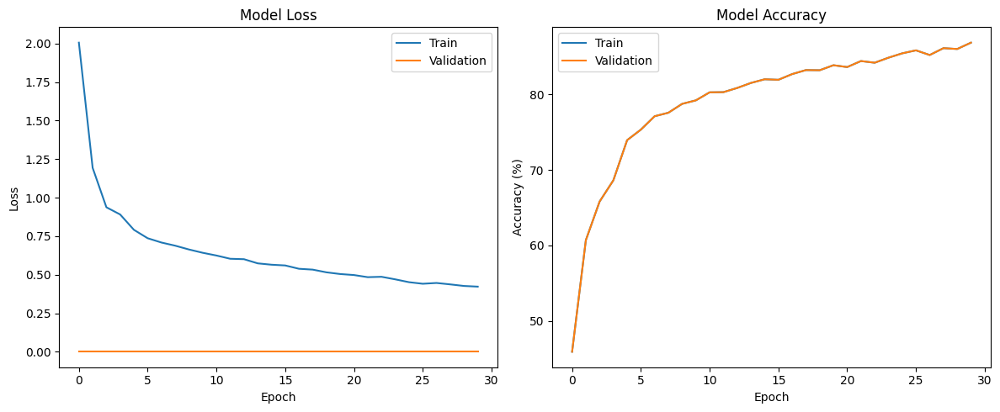

Loading questions from: /kaggle/input/aerial-imagery-dataset-floodnet-challenge/FloodNet Challenge - Track 2/Questions/Training Question.json
Sample question data: {'Image_ID': '10165.JPG', 'Question': 'What is the overall condition of the given image?', 'Ground_Truth': 'flooded', 'Question_Type': 'Condition_Recognition'}
Total questions loaded: 4511
Vocabulary size: 24, Number of answer classes: 32
Loading questions from: /kaggle/input/aerial-imagery-dataset-floodnet-challenge/FloodNet Challenge - Track 2/Questions/Valid Question.json
Sample question data: {'Image_ID': '10169.JPG', 'Question': 'What is the overall condition of the given image?', 'Question_Type': 'Condition_Recognition'}
Total questions loaded: 1415
Vocabulary size: 24, Number of answer classes: 0

Visualizing predictions on training set...


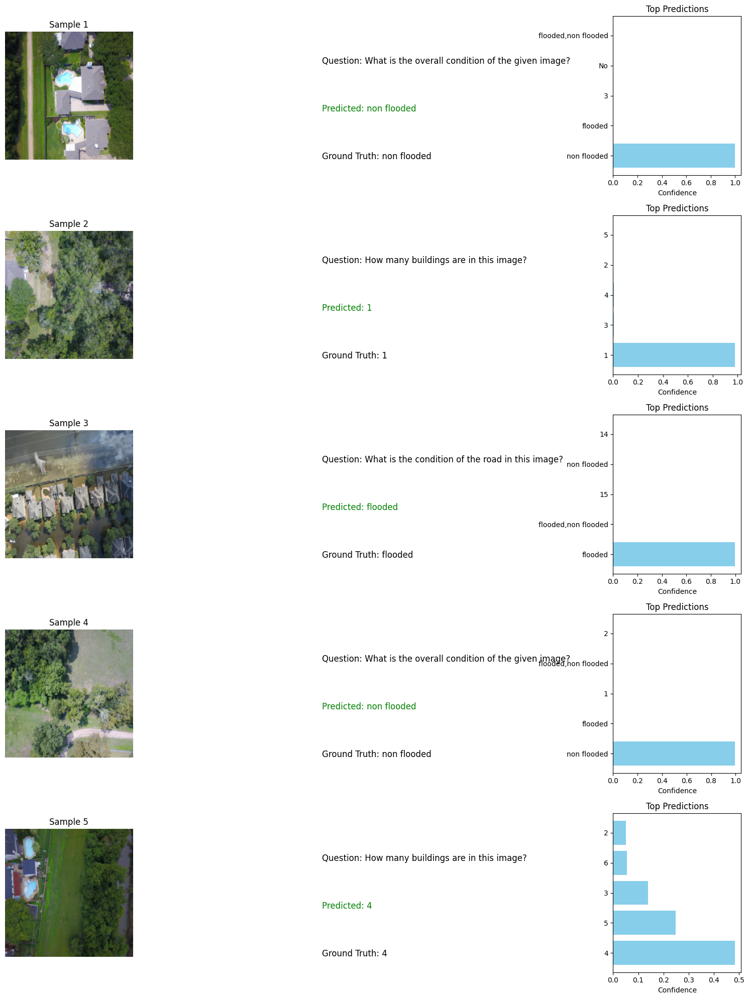


Generating confusion matrix...


In [ ]:
# Load the best model
def load_best_model(model_path, device):
    checkpoint = torch.load(model_path)
    
    # Create model with the same architecture
    model = SimpleVQA(
        vocab_size=len(checkpoint['vocab']),
        num_classes=len(checkpoint['ans_to_idx']),
        embed_size=256,
        hidden_size=512
    )
    
    # Load weights
    model.load_state_dict(checkpoint['model_state_dict'])
    model = model.to(device)
    model.eval()
    
    return model, checkpoint

# Visualize results
def visualize_all_results():
    # Load the best model
    best_model_path = '/kaggle/working/best_model.pth'
    model, checkpoint = load_best_model(best_model_path, device)
    
    print(f"Loaded model from epoch {checkpoint['epoch']} with validation accuracy: {checkpoint['val_acc']:.2f}%")
    
    # Visualize training history
    if 'history' in locals() or 'history' in globals():
        print("Visualizing training history...")
        visualize_training_history(history)
    else:
        print("Training history not available")
    
    # Load datasets for visualization
    DATA_DIR = '/kaggle/input/aerial-imagery-dataset-floodnet-challenge/FloodNet Challenge - Track 2'
    
    _, train_dataset = get_loader(
        data_dir=DATA_DIR,
        batch_size=1,  # Batch size doesn't matter for visualization
        split='train',
        shuffle=False
    )
    
    _, val_dataset = get_loader(
        data_dir=DATA_DIR,
        batch_size=1,
        split='valid',
        shuffle=False
    )
    
    # Visualize predictions on training set
    print("\nVisualizing predictions on training set...")
    visualize_predictions(model, train_dataset, device)
    
    # Visualize confusion matrix
    print("\nGenerating confusion matrix...")
    visualize_confusion_matrix(model, train_dataset, device)
    
    print("\nVisualization complete! Check the output files in the /kaggle/working directory.")

# Run visualization
visualize_all_results()